# BOnScope DB Viewer & Analysis
### Visualization for Linux W/S DB

In [93]:
# 라이브러리 불러오기

import os
import sys
import pymysql
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.io as pio
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import time
from scipy.optimize import curve_fit
from sklearn.metrics import r2_score
import plotlyuser as pu
import kuserlib as k
import sqldblib as sq

# 신규 워크스테이션 (리눅스, DB 2가지 : gsmbiz, gsmbiz_result)
conn = pymysql.connect(host='192.168.0.125', user='gsmbiz_master', password='mintech1234!', port=3306, db='gsmbiz_result', local_infile=False)
conn_db = pymysql.connect(host='192.168.0.125', user='gsmbiz_master', password='mintech1234!', port=3306, db='gsmbiz', local_infile=False)


columns_name = ['deviceNo', 'messageTime', 'time', 'startTime', 'internalTemp',
       'externalTemp', 'soc', 'acceptableChargingPower',
       'acceptableDischargingPower', 'mainRelayConnected',
       'slowChargingPortConnected', 'fastChargingPortConnected', 'v2l',
       'packCurrent', 'packVoltage', 'moduleMaxTemp', 'moduleMinTemp',
       'moduleTempList', 'battInternalTemp', 'maxCellVoltage',
       'maxCellVoltageNo', 'minCellVoltage', 'minCellVoltageNo',
       'battFanRunning', 'subBattVoltage', 'cumulativeCurrentCharged',
       'cumulativeCurrentDischarged', 'cumulativePowerCharged',
       'cumulativePowerDischarged', 'operationTime', 'bmsRunning',
       'inverterCapacityVoltage', 'driveMotorSpd1', 'driveMotorSpd2',
       'insulatedResistance', 'cellVoltageList', 'cellVoltageDispersion',
       'airbagHWireDuty', 'hvacList1', 'hvacList2', 'soh',
       'maxDeteriorationCellNo', 'minDeterioratation',
       'minDeteriorationCellNo', 'socd', 'emobilitySpeed', 'moduleAvgTemp',
       'batteryPower', 'odometer', 'fastChargingRelayOn',
       'chargingCableConnected', 'estimatedChargingTime', 'tripChargingPower',
       'tripDischargingPower', 'battCoolantInletTemp', 'battPraBusbarTemp',
       'battLtrRearTemp', 'chargeCount', 'chargeCountQuick', 'umulEnergyChrgd',
       'cumulEnergyChrgdQuick']


# 부동소수점 표현 변경
pd.options.display.float_format = '{:.4f}'.format


In [94]:
# DB 용량 확인하기

db_name = 'gsmbiz_result'

sq.check_dbsize(conn, db_name)

,DB name,size_MB
0,information_schema,0.0
1,performance_schema,0.0
2,gsmbiz_result,24.7
3,gsmbiz,1436666.4
4,dev_gsmbiz_result,11.8
5,old_gsmbiz_result,58.4


In [95]:
# 전체 DB Table 리스트 확인하기

sq.view_tablelist(conn)

,table_name
0,car_info
1,car_spec
2,exe_log
3,summary
4,time_log
5,v2_cal_soh
6,v2_drive_record
7,v2_exe_log
8,v2_fin_result
9,v2_outlier_record


In [96]:
table_name = 'car_spec'

car_spec = sq.read_table_all(conn, table_name)
car_spec

Table name :  car_spec


,car_model,pack_config,module_config,nominal_voltage,nominal_energy,nominal_capacity,energy_efficiency,release_date
0,GV60,2P_192S,2P_6S,3.6317,77.4000,111.0000,4.6000,2021.10.
1,아이오닉5,2P_180S,2P_6S,3.6270,72.6000,111.2000,4.8500,2021.04.
2,EV6,2P_192S,2P_6S,3.6252,77.4000,111.2000,4.7500,2021.08.
3,코나EV,3P_98S,20S,3.6281,64.0000,180.0000,5.7000,2018.04.
4,아이오닉일렉트릭(AE),2P_96S,-,3.7393,28.0000,78.0000,6.3000,2016.06.
5,아이오닉5스탠다드,2P_144S,2P_6S,3.6720,58.8000,111.2000,4.8500,2021.04.
6,봉고3,3P_90S,-,3.6296,58.8000,180.0000,2.9000,2019.09.
7,포터2,3P_90S,-,3.6296,58.8000,180.0000,2.9000,2019.12.
8,EV6스탠다드,2P_144S,2P_6S,3.6720,58.8000,111.2000,4.7500,2021.08.
9,니로EV(~2021년식),3P_98S,20S,3.6281,64.0000,180.0000,5.3000,2022.06.


In [97]:
table_name = 'car_info'

car_info = sq.read_table_all(conn, table_name)
car_info

Table name :  car_info


,car_num,reg_date,car_model,release,cell_cnt,batteryReplace,qstd
0,01229662196,2022-10-07 02:59:47,GV60,20220623,192,,111.0000
1,01229663082,2022-09-23 07:32:12,GV60,20220301,192,,111.0000
2,01229663432,2022-10-07 02:57:24,GV60,20220615,192,,111.0000
3,01229664528,2022-10-07 02:57:48,GV60,20220615,192,,111.0000
4,01229994779,2022-09-16 01:19:57,아이오닉5,20220301,180,2022-12,111.0000
...,...,...,...,...,...,...,...
514,01241248539,2024-04-03 15:30:00,EV6,20221201,192,,111.0000
515,01241597857,2024-04-05 16:30:00,아이오닉5,20221201,180,2020-10,111.0000
516,01241597856,2024-04-05 16:30:00,아이오닉5,20221201,180,,111.0000
517,01241597853,2024-04-05 16:30:00,아이오닉5,20221201,180,,111.0000


In [98]:
table_name = 'summary'

df_summary = sq.read_table_all(conn, table_name)
df_summary

Table name :  summary


,upload_date,car_model,car_id,start_time,end_time,time_range,cum_currentcharged,cum_currentdischarged,start_odometer,end_odometer,...,reset_rev,power_reset_value,rev_ep_ratio,reset_final,record_time_ratio,cell_cnt,cell_voltage_diff,fast_charge_ratio,overheating_time,subcooling_time
0,2024-01-28 04:55:44,포터2,01241228027,2023-01-19 18:11:21,2024-01-28 00:08:38,373,1026.9000,952.7000,10707.0000,25438.0000,...,0,-32.6798,3.9100,1,16.0000,90,0.1000,0.0250,0,0
1,2024-01-28 04:55:44,EV6,01241228089,2024-01-23 12:13:46,2024-01-26 18:14:48,3,1536.0000,1399.0000,5032.0000,5210.0000,...,None,-32.6365,3.6400,0,9.1000,1,0.0000,1.0000,0,0
2,2024-01-28 04:55:44,EV6,01241248892,2023-01-16 11:16:47,2024-01-28 00:10:28,376,6282.8000,6128.7000,34226.0000,66648.0000,...,0,1258.2900,4.3300,0,20.1000,192,0.1400,0.0150,0,0
3,2024-01-28 04:55:44,EV6,01241592884,2023-08-23 10:15:53,2024-01-27 22:03:38,157,8571.6000,8201.5000,12295.0000,31615.0000,...,None,-406.0840,3.6700,0,18.6000,192,0.1400,0.8190,0,0
4,2024-01-28 04:55:44,포터2,01241248721,2023-05-01 06:45:19,2023-11-14 15:29:19,197,183.4000,174.5000,21067.0000,27670.0000,...,0,627.7910,2.7300,0,22.9000,90,0.0200,0.0310,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16490,2024-04-16 15:20:37,포터2,01241228188,2023-05-01 02:37:37,2024-01-30 17:45:30,274,0.0000,0.0000,5899.0000,5996.0000,...,0,-38066.6000,0.0600,0,47.9000,90,0.0600,0.1050,0,0
16491,2024-04-16 15:20:37,니로EV(~2021년식),01241228155,2023-06-05 11:21:42,2023-12-15 15:11:30,193,13549.3000,13197.3000,108096.0000,117264.0000,...,None,-11603.9000,4.7300,0,12.5000,98,0.0200,0.0160,0,0
16492,2024-04-16 15:20:37,포터2,01241321914,2023-04-03 08:17:36,2024-04-15 23:59:58,378,13907.3000,13294.3000,27006.0000,34634.0000,...,None,367.9170,2.6800,0,8.2000,90,0.1400,0.9410,0,0
16493,2024-04-16 15:20:37,EV6,01241288308,2024-03-05 11:29:21,2024-04-15 15:01:32,41,7905.0000,7728.0000,43175.0000,46432.0000,...,None,-2385.1600,4.5900,0,15.7000,1,0.0000,0.0190,0,0


In [99]:
# 최근 데이터만 가져오기

resent_time = df_summary['upload_date'].unique()[-1:][0]

df_summary = df_summary[df_summary['upload_date'] == resent_time].reset_index(drop=True)
df_summary.head()

,upload_date,car_model,car_id,start_time,end_time,time_range,cum_currentcharged,cum_currentdischarged,start_odometer,end_odometer,...,reset_rev,power_reset_value,rev_ep_ratio,reset_final,record_time_ratio,cell_cnt,cell_voltage_diff,fast_charge_ratio,overheating_time,subcooling_time
0,2024-04-16 15:20:37,아이오닉5,01241228013,2022-12-08 16:10:19,2023-10-16 19:49:35,312,4856.7000,4560.0000,19379.0000,28240.0000,...,None,-509.1450,5.5700,0,7.1000,180,0.0800,0.1590,0,0
1,2024-04-16 15:20:37,포터2,01241321907,2023-02-21 13:48:48,2023-11-30 09:00:30,281,2870.6000,2788.0000,26279.0000,74191.0000,...,0,1169.6500,4.2000,1,24.7000,90,0.1600,0.3150,0,0
2,2024-04-16 15:20:37,EV6,01241364628,2023-08-28 14:43:37,2024-04-15 20:31:49,231,2713.8000,2595.9000,6025.0000,14142.0000,...,1,-49.9904,5.3400,0,11.4000,192,0.0400,0.0050,0,2
3,2024-04-16 15:20:37,EV6,01241248891,2023-01-16 12:09:05,2024-04-15 17:21:22,455,7672.1000,7432.2000,2511.0000,29295.0000,...,None,172.4940,4.0400,0,15.8000,192,0.1200,0.0130,0,0
4,2024-04-16 15:20:37,EV6,01241597765,2023-10-24 09:42:27,2024-04-15 09:22:25,173,5753.4000,5585.8000,28239.0000,39630.0000,...,None,-4084.4200,4.1000,0,10.0000,192,0.0800,0.1970,0,0


In [165]:
# 데이터 조회하기

table_name = 'v2_cal_soh'

start_time = time.time()

df_cal_soh = sq.read_table_all(conn, table_name)

end_time = time.time()

spend_time = end_time - start_time
spend_min = spend_time//60
sec = spend_time%60
print('Time spend : ', int(spend_min), 'min', round(sec, 2), 'sec')

df_cal_soh

Table name :  v2_cal_soh
Time spend :  0 min 2.03 sec


,upload_date,car_id,car_model,start_index,end_index,start_time,end_time,charge_minutes,model_year,end_cycle,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_soh,delta_Q,SOH_prediction
0,2024-04-18 16:40:00,01241228050,EV6,1620,11881,2023-03-15 17:57:19,2023-03-16 04:33:18,636.0000,0.9600,1.0400,26.5000,96.5000,70.0000,27191,80.5000,100.0000,80.0000,102.7700
1,2024-04-18 16:40:00,01241228050,EV6,21013,34679,2023-03-21 17:51:47,2023-03-22 01:28:26,456.6000,0.9700,2.2933,39.0000,87.5000,48.5000,27391,177.5000,100.0000,55.2000,102.3500
2,2024-04-18 16:40:00,01241228050,EV6,52247,53801,2023-03-26 20:45:13,2023-03-27 13:39:08,1013.9000,0.9900,3.3553,51.5000,87.5000,36.0000,27751,259.7000,100.0000,41.0000,102.4200
3,2024-04-18 16:40:00,01241228050,EV6,63017,68909,2023-03-29 13:43:12,2023-03-29 16:59:39,196.4000,0.9900,4.0956,27.5000,53.5000,26.0000,27999,317.0000,100.0000,29.5000,102.0300
4,2024-04-18 16:40:00,01241228050,EV6,71677,77418,2023-03-30 07:44:14,2023-03-30 10:55:38,191.4000,1.0000,4.3618,31.0000,55.5000,24.5000,28098,337.6000,100.0000,27.8000,102.0400
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67663,2024-04-21 00:44:03,01241597823,포터2,1299,9228,2024-04-19 12:30:49,2024-04-19 16:55:10,264.4000,0.7200,34.1667,42.0000,61.0000,19.0000,8104,2009.0000,100.0000,36.0000,105.2600
67664,2024-04-21 00:44:03,01241597823,포터2,10678,22658,2024-04-19 20:36:57,2024-04-20 03:16:25,399.5000,0.7200,34.2517,57.0000,86.0000,29.0000,8120,2014.0000,100.0000,55.0000,105.3600
67665,2024-04-21 00:44:08,01241597837,EV6,3677,18750,2024-04-20 00:09:13,2024-04-20 08:31:46,502.6000,2.2200,98.2171,35.0000,96.0000,61.0000,62093,7602.0000,100.0000,69.0000,101.7200
67666,2024-04-21 00:44:15,01241597852,아이오닉5,2623,9147,2024-04-19 17:04:48,2024-04-19 20:42:19,217.5000,2.4700,49.8072,49.0000,77.0000,28.0000,75496,3616.0000,100.0000,32.0000,102.7700


In [153]:
# 최근 데이터만 가져오기

resent_time = df_cal_soh.loc[len(df_cal_soh)-1, 'upload_date'].date()

df_cal_soh = df_cal_soh[df_cal_soh['upload_date'].dt.date == resent_time].reset_index(drop=True)
df_cal_soh

,upload_date,car_id,car_model,start_index,end_index,start_time,end_time,charge_minutes,model_year,end_cycle,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_soh,delta_Q,SOH_prediction
0,2024-04-21 00:10:03,01229668677,EV6,3093,20242,2024-04-20 00:08:10,2024-04-20 09:39:56,571.8000,1.8100,120.6330,36.0000,76.0000,40.0000,44165,9337.0000,100.0000,45.0000,101.1700
1,2024-04-21 00:10:30,01241225227,EV6,8534,25208,2024-04-19 22:33:27,2024-04-20 07:49:23,555.9000,0.7200,64.7028,10.0000,81.0000,71.0000,18340,5008.0000,100.0000,81.0000,102.5900
2,2024-04-21 00:11:03,01241228014,아이오닉5,18595,31636,2024-04-19 22:22:09,2024-04-20 05:36:58,434.8000,1.5500,264.2270,34.0000,87.0000,53.0000,84711,19182.9000,100.0000,60.4000,102.4800
3,2024-04-21 00:11:19,01241228021,아이오닉5,2958,4750,2024-04-19 21:01:45,2024-04-19 22:01:30,59.8000,2.8900,213.2950,77.0000,87.0000,10.0000,74591,15485.2000,96.3000,11.2000,100.7200
4,2024-04-21 00:11:28,01241228024,아이오닉5,492,4700,2024-04-19 08:57:49,2024-04-19 11:18:07,140.3000,1.8000,142.7480,78.5000,96.5000,18.0000,38945,10363.5000,100.0000,20.4000,101.9200
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
176,2024-04-21 00:44:03,01241597823,포터2,1299,9228,2024-04-19 12:30:49,2024-04-19 16:55:10,264.4000,0.7200,34.1667,42.0000,61.0000,19.0000,8104,2009.0000,100.0000,36.0000,105.2600
177,2024-04-21 00:44:03,01241597823,포터2,10678,22658,2024-04-19 20:36:57,2024-04-20 03:16:25,399.5000,0.7200,34.2517,57.0000,86.0000,29.0000,8120,2014.0000,100.0000,55.0000,105.3600
178,2024-04-21 00:44:08,01241597837,EV6,3677,18750,2024-04-20 00:09:13,2024-04-20 08:31:46,502.6000,2.2200,98.2171,35.0000,96.0000,61.0000,62093,7602.0000,100.0000,69.0000,101.7200
179,2024-04-21 00:44:15,01241597852,아이오닉5,2623,9147,2024-04-19 17:04:48,2024-04-19 20:42:19,217.5000,2.4700,49.8072,49.0000,77.0000,28.0000,75496,3616.0000,100.0000,32.0000,102.7700


In [172]:
# 필터 조건

data_soh = df_cal_soh[df_cal_soh['delta_soc'] > 50]
data_soh = data_soh[df_cal_soh['SOH_prediction'] < 120]
data_soh = data_soh[df_cal_soh['SOH_prediction'] > 70]
data_soh = data_soh[data_soh['start_soc'] != 0]
data_soh

C:\Users\minms\AppData\Local\Temp\ipykernel_3032\993533584.py:4: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\minms\AppData\Local\Temp\ipykernel_3032\993533584.py:5: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,upload_date,car_id,car_model,start_index,end_index,start_time,end_time,charge_minutes,model_year,end_cycle,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_soh,delta_Q,SOH_prediction
0,2024-04-18 16:40:00,01241228050,EV6,1620,11881,2023-03-15 17:57:19,2023-03-16 04:33:18,636.0000,0.9600,1.0400,26.5000,96.5000,70.0000,27191,80.5000,100.0000,80.0000,102.7700
6,2024-04-18 16:40:00,01241228050,EV6,101862,114890,2023-04-04 18:28:38,2023-04-05 01:43:00,434.4000,1.0100,5.6589,33.0000,83.5000,50.5000,28369,438.0000,100.0000,57.5000,102.3900
23,2024-04-18 16:40:00,01241228050,EV6,399865,416287,2023-05-13 20:55:08,2023-05-14 06:03:39,548.5000,1.1200,14.2739,30.0000,96.0000,66.0000,31520,1104.8000,100.0000,75.2000,102.4600
33,2024-04-18 16:40:00,01241228050,EV6,542995,561955,2023-06-06 00:44:19,2023-06-06 11:16:27,632.1000,1.1800,20.9974,13.5000,87.0000,73.5000,33621,1625.2000,100.0000,83.8000,102.5300
34,2024-04-18 16:40:00,01241228050,EV6,569953,591375,2023-06-08 19:12:08,2023-06-09 07:06:22,714.2000,1.1900,21.6008,41.5000,93.0000,51.5000,33843,1671.9000,100.0000,58.8000,102.6800
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67650,2024-04-21 00:42:52,01241597768,EV6,2948,16380,2024-04-19 22:01:57,2024-04-20 05:29:49,447.9000,0.7200,76.2119,42.0000,96.5000,54.5000,22614,5898.8000,100.0000,62.0000,102.3000
67651,2024-04-21 00:42:59,01241597769,EV6,13714,34982,2024-04-19 22:42:06,2024-04-20 10:36:06,714.0000,1.4700,178.1740,15.0000,88.5000,73.5000,76681,13790.7000,100.0000,83.9000,102.6500
67657,2024-04-21 00:43:32,01241597794,EV6,10254,28729,2024-04-19 16:50:38,2024-04-20 03:06:36,616.0000,0.6400,81.5762,26.0000,96.0000,70.0000,26431,6314.0000,100.0000,79.0000,101.4900
67658,2024-04-21 00:43:47,01241597805,EV6,14905,17291,2024-04-19 22:43:09,2024-04-20 00:02:42,79.6000,1.4700,291.4860,31.0000,96.0000,65.0000,76640,22561.0000,96.0000,74.0000,102.3800


In [173]:
input_df = data_soh
x_name = 'end_cycle'
y_name = 'SOH_prediction'
z_name = 'car_model'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [174]:
data_soh[data_soh['SOH_prediction'] < 100]

,upload_date,car_id,car_model,start_index,end_index,start_time,end_time,charge_minutes,model_year,end_cycle,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_soh,delta_Q,SOH_prediction
2785,2024-04-19 09:32:14,01241228016,아이오닉5,2481732,2494695,2024-03-09 22:18:02,2024-03-11 03:04:25,1726.4000,2.4400,122.3540,38.5000,90.5000,52.0000,35303,8882.9000,97.2000,55.8000,96.5000
17623,2024-04-19 10:16:54,01241228161,봉고3,1419608,1421978,2023-06-09 06:44:16,2023-06-09 08:37:53,113.6000,1.4400,143.7720,36.5000,95.5000,59.0000,25715,8453.8000,100.0000,102.0000,96.0500
43966,2024-04-19 11:25:12,01241248850,EV6,601670,604476,2023-04-08 17:51:11,2023-04-09 04:53:09,662.0000,1.6900,141.1520,29.0000,96.5000,67.5000,63523,10925.2000,100.0000,74.1000,98.7200
55067,2024-04-19 11:58:54,01241364602,EV6,558676,578855,2023-10-21 17:52:14,2023-10-22 09:25:14,933.0000,1.4800,23.9703,21.5000,91.0000,69.5000,23199,1855.3000,100.0000,75.3000,97.4300
60086,2024-04-19 12:17:13,01241592895,아이오닉5스탠다드,230104,237641,2023-10-15 02:17:31,2023-10-16 15:57:47,2260.3000,1.2100,96.7551,26.5000,96.5000,70.0000,20524,5689.2000,100.0000,76.7000,98.5400
60846,2024-04-19 12:19:20,01241592908,EV6,2564903,2598562,2024-04-02 20:41:12,2024-04-04 07:55:58,2114.8000,1.4300,68.8979,31.0000,95.5000,64.5000,36060,5332.7000,99.8000,71.5000,99.6900
66037,2024-04-19 12:36:07,01241597793,EV6,32419,33546,2023-11-16 00:04:39,2023-11-16 00:42:13,37.6000,1.7100,23.3850,38.0000,93.0000,55.0000,87973,1810.0000,100.0000,61.0000,99.7400
66855,2024-04-19 12:38:43,01241597819,EV6,10749,12167,2024-01-22 13:28:42,2024-01-22 14:15:59,47.3000,0.3100,12.2481,36.0000,90.0000,54.0000,4613,948.0000,100.0000,60.0000,99.9200


In [219]:
# 특정 차량 선택

select_car_id = '01241364674'

data_soh[data_soh['car_id'] == select_car_id]

,upload_date,car_id,car_model,start_index,end_index,start_time,end_time,charge_minutes,model_year,end_cycle,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_soh,delta_Q,SOH_prediction
56723,2024-04-19 12:05:12,01241364674,봉고3,148376,160616,2023-06-19 16:51:40,2023-06-20 00:45:33,473.9000,0.1400,5.6633,13.5000,86.5000,73.0000,1057,333.0000,100.0000,138.4000,105.3300
56733,2024-04-19 12:05:12,01241364674,봉고3,402695,413005,2023-07-07 06:10:05,2023-07-07 11:53:50,343.8000,0.1800,10.7908,36.0000,86.5000,50.5000,1711,634.5000,100.0000,95.6000,105.1700
56742,2024-04-19 12:05:12,01241364674,봉고3,671788,682030,2023-07-27 06:17:22,2023-07-27 11:58:51,341.5000,0.2400,16.6463,36.0000,86.5000,50.5000,2453,978.8000,100.0000,95.6000,105.1700
56744,2024-04-19 12:05:12,01241364674,봉고3,724706,735444,2023-07-31 05:41:59,2023-07-31 11:39:59,358.0000,0.2500,17.7959,33.5000,86.5000,53.0000,2588,1046.4000,100.0000,100.4000,105.2400
56745,2024-04-19 12:05:12,01241364674,봉고3,760339,770957,2023-08-04 06:25:06,2023-08-04 12:22:59,357.9000,0.2600,18.5765,34.0000,86.5000,52.5000,2680,1092.3000,100.0000,99.3000,105.0800
56748,2024-04-19 12:05:12,01241364674,봉고3,865080,875543,2023-08-11 06:43:36,2023-08-11 12:32:27,348.8000,0.2800,20.8027,35.0000,86.5000,51.5000,2963,1223.2000,100.0000,97.5000,105.1800
56749,2024-04-19 12:05:12,01241364674,봉고3,899651,910564,2023-08-13 06:19:13,2023-08-13 12:23:04,363.8000,0.2900,21.5833,33.0000,86.5000,53.5000,3064,1269.1000,100.0000,101.3000,105.1900
56750,2024-04-19 12:05:12,01241364674,봉고3,934399,944819,2023-08-15 06:38:28,2023-08-15 12:25:53,347.4000,0.2900,22.3656,35.0000,86.5000,51.5000,3161,1315.1000,100.0000,97.5000,105.1800
56752,2024-04-19 12:05:12,01241364674,봉고3,1000370,1012353,2023-08-22 09:08:17,2023-08-22 15:48:49,400.5000,0.3100,23.9796,27.0000,86.0000,59.0000,3358,1410.0000,100.0000,111.8000,105.2700
56753,2024-04-19 12:05:12,01241364674,봉고3,1038230,1049923,2023-08-24 06:44:09,2023-08-24 13:16:41,392.5000,0.3200,24.8265,28.0000,86.5000,58.5000,3461,1459.8000,100.0000,111.4000,105.7900


In [220]:
len(data_soh[data_soh['car_id'] == select_car_id])

51

In [221]:
input_df = data_soh[data_soh['car_id'] == select_car_id]
x_name = 'end_cycle'
y_name = 'SOH_prediction'
z_name = 'car_id'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [216]:
input_df[input_df['SOH_prediction'] == 104.76]

,upload_date,car_id,car_model,start_index,end_index,start_time,end_time,charge_minutes,model_year,end_cycle,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_soh,delta_Q,SOH_prediction
55965,2024-04-19 12:02:12,01241364634,봉고3,3412050,3423496,2023-11-03 18:01:36,2023-11-04 00:23:13,381.6000,0.5100,134.4440,40.0000,96.0000,56.0000,18858,7905.3000,100.0000,105.6000,104.7600
56113,2024-04-19 12:02:12,01241364634,봉고3,6971227,6981551,2024-04-02 23:12:21,2024-04-03 04:56:36,344.2000,0.9300,254.2400,43.0000,95.5000,52.5000,34990,14949.3000,100.0000,99.0000,104.7600


R-squared :  0.024
Correlation :  0.154


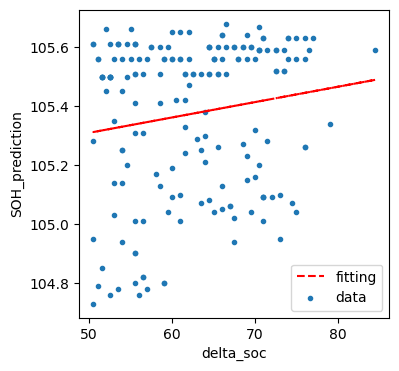

In [218]:
k.check_correlation(input_df, 'delta_soc', 'SOH_prediction')

## DB Summary view

In [154]:
df_summary.columns

Index(['upload_date', 'car_model', 'car_id', 'start_time', 'end_time',
       'time_range', 'cum_currentcharged', 'cum_currentdischarged',
       'start_odometer', 'end_odometer', 'odometer', 'year_odometer', 'cycle',
       'nominal_energy', 'public_ratio', 'ep_ratio', 'month_ep_ratio',
       'reset_TF', 'reset_time', 'reset_start', 'reset_end', 'reset_rev',
       'power_reset_value', 'rev_ep_ratio', 'reset_final', 'record_time_ratio',
       'cell_cnt', 'cell_voltage_diff', 'fast_charge_ratio',
       'overheating_time', 'subcooling_time'],
      dtype='object')

In [155]:
# 전체 데이터 Pivot 정리

Dataset = df_summary
total_pivot = pd.pivot_table(Dataset, values='reset_TF', index='car_model', aggfunc=['count', 'sum'])
total_pivot = total_pivot.fillna(0)
total_pivot['reset_pct'] = total_pivot.iloc[:, 1]/total_pivot.iloc[:, 0]*100

print('Total Car : ', total_pivot.iloc[:, 0].sum())
print('Reset Car : ', total_pivot.iloc[:, 1].sum())
print('Total Reset Percent [%] : ', round(total_pivot.iloc[:, 1].sum()/total_pivot.iloc[:, 0].sum()*100, 2))

total_pivot

Total Car :  501
Reset Car :  224
Total Reset Percent [%] :  44.71


,count,sum,reset_pct
,reset_TF,reset_TF,
car_model,,,
EV6,254,102,40.1575
EV6스탠다드,7,2,28.5714
GV60,17,1,5.8824
니로EV(~2021년식),7,2,28.5714
봉고3,37,26,70.2703
아이오닉5,54,23,42.5926
아이오닉5(2023~),1,0,0.0000
아이오닉5스탠다드,2,0,0.0000


In [156]:
# 특정 차량의 전비 데이터 확인

car_model = '코나EV'

Data_ep_ratio = Dataset.loc[:, ['car_model', 'car_id', 'ep_ratio', 'month_ep_ratio']][Dataset['car_model'] == car_model].sort_values(by='month_ep_ratio')

In [157]:
Data_ep_ratio = Data_ep_ratio[Data_ep_ratio['ep_ratio'].isna() == False]

In [162]:
# 전비 통계량 확인

print('평균 전비 : ', Data_ep_ratio['month_ep_ratio'].mean())
print('최대 전비 : ', Data_ep_ratio['month_ep_ratio'].max())
print('최소 전비 : ', Data_ep_ratio['month_ep_ratio'].min())
print('전비 표준편차 : ',Data_ep_ratio['month_ep_ratio'].std())

평균 전비 :  5.03529411764706
최대 전비 :  5.76
최소 전비 :  3.86
전비 표준편차 :  0.5742943240083741


In [163]:
# 차량 전비 확인  #달콩이 '01241248903', 회사 코나 01241124056

Data_ep_ratio[Data_ep_ratio['car_id'] == '01241124056']

,car_model,car_id,ep_ratio,month_ep_ratio
16,코나EV,01241124056,189.7300,4.4700


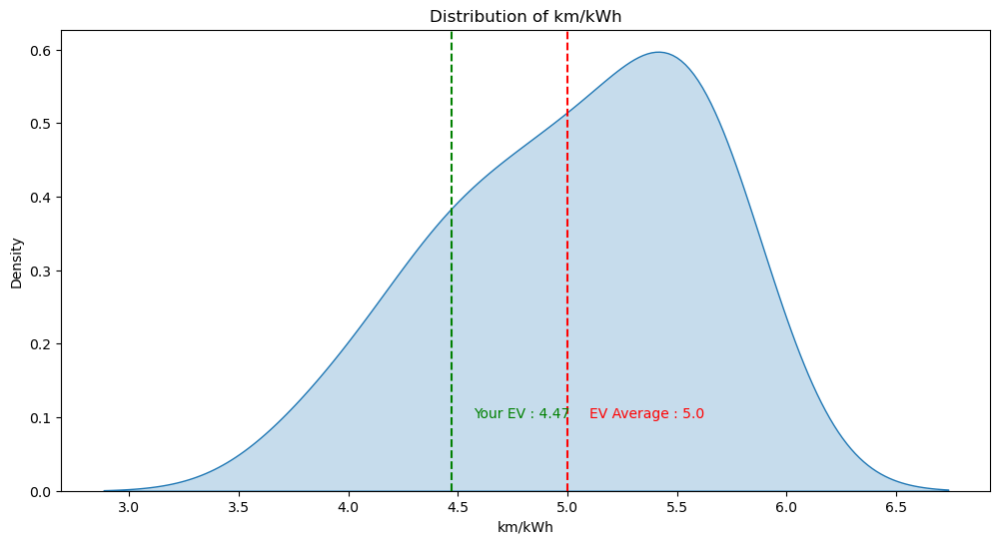

In [31]:
# 전비 데이터 시각화

data = Data_ep_ratio

plt.figure(figsize=(12, 6))
sns.kdeplot(data['month_ep_ratio'], fill=True)  # KDE 플롯을 생성합니다.

# 그래프에 평균 수치 표기
specific_value = 5.0
plt.axvline(x=specific_value, color='r', linestyle='--')  # 특정 수치에 해당하는 선을 그래프에 추가합니다.
plt.text(specific_value + 0.1, 0.1, 'EV Average : ' + str(specific_value), color='r')  # 원하는 위치에 특정 수치를 표기합니다.

# 그래프에 특정 수치 표기
specific_value = 4.47
plt.axvline(x=specific_value, color='g', linestyle='--')  # 특정 수치에 해당하는 선을 그래프에 추가합니다.
plt.text(specific_value + 0.1, 0.1, 'Your EV : ' + str(specific_value), color='g')  # 원하는 위치에 특정 수치를 표기합니다.

# 그래프 제목, 축 라벨 등 추가
plt.title('Distribution of km/kWh')
plt.xlabel('km/kWh')
plt.ylabel('Density')

# 그래프 출력
plt.show()

In [33]:
# 순위 퍼센트로 확인하기

from scipy.stats import percentileofscore

# 데이터 프레임에서 특정 수치의 백분위 순위 확인
target_value = 4.47

percentile_rank = percentileofscore(data['month_ep_ratio'], target_value)
print(f"{target_value}가 데이터에서 차지하는 순위는 상위 {100 - percentile_rank:.2f}% 입니다.")

4.47가 데이터에서 차지하는 순위는 상위 82.35% 입니다.


In [37]:
print('Rank : ', len(data) * percentile_rank/100, '@', len(data))

Rank :  3.0 @ 17


In [128]:
Dataset.columns

Index(['upload_date', 'car_model', 'car_id', 'start_time', 'end_time',
       'time_range', 'cum_currentcharged', 'cum_currentdischarged',
       'start_odometer', 'end_odometer', 'odometer', 'year_odometer', 'cycle',
       'nominal_energy', 'public_ratio', 'ep_ratio', 'month_ep_ratio',
       'reset_TF', 'reset_time', 'reset_start', 'reset_end', 'reset_rev',
       'power_reset_value', 'rev_ep_ratio', 'reset_final', 'record_time_ratio',
       'cell_cnt', 'cell_voltage_diff', 'fast_charge_ratio',
       'overheating_time', 'subcooling_time'],
      dtype='object')

In [155]:
# 특정 차량의 Cell Voltage Difference, odometer 데이터 확인

Data_cell_balance = Dataset.loc[:, ['car_model', 'car_id', 'month_ep_ratio', 'odometer', 'cell_voltage_diff']][Dataset['car_model'] == 'EV6'].sort_values(by='cell_voltage_diff')

In [156]:
# 평균확인

Data_cell_balance['cell_voltage_diff'].mean()

0.07258064516129033

In [157]:
# 최대확인

Data_cell_balance['cell_voltage_diff'].max()

1.0

In [158]:
# 최소확인

Data_cell_balance['cell_voltage_diff'].min()

0.0

In [159]:
# 표준편차 확인

Data_cell_balance['cell_voltage_diff'].std()

0.0865522328804181

In [160]:
len(Data_cell_balance)

248

In [131]:
# 달콩이 차량 확인

Data_cell_balance[Data_cell_balance['car_id'] == '01241248903']

,car_model,car_id,month_ep_ratio,cell_voltage_diff
448,EV6,01241248903,6.5000,0.0600


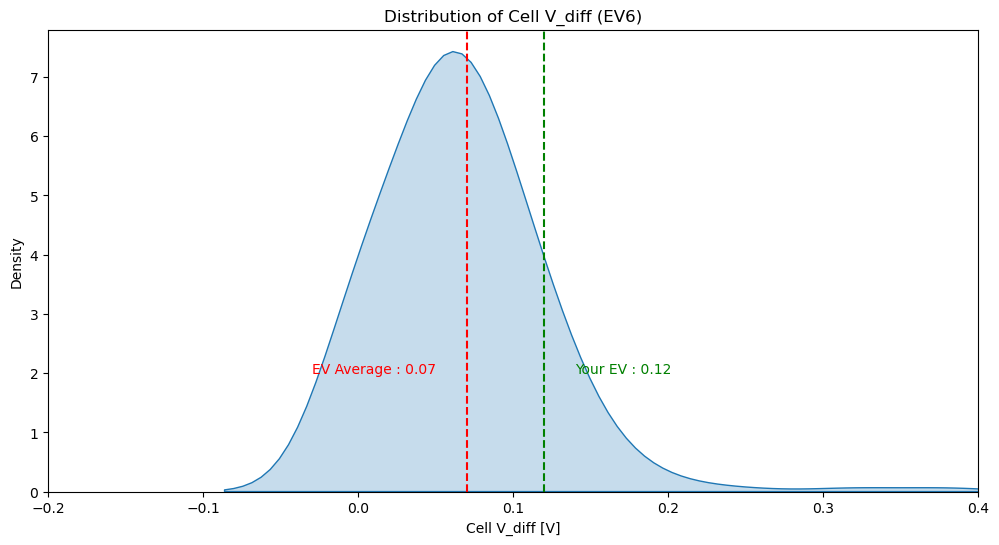

In [167]:
# 전비 데이터 시각화

data = Data_cell_balance

plt.figure(figsize=(12, 6))
sns.kdeplot(data['cell_voltage_diff'], fill=True)  # KDE 플롯을 생성합니다.

# 그래프에 평균 수치 표기
specific_value = 0.07
plt.axvline(x=specific_value, color='r', linestyle='--')  # 특정 수치에 해당하는 선을 그래프에 추가합니다.
plt.text(specific_value - 0.1, 2, 'EV Average : ' + str(specific_value), color='r')  # 원하는 위치에 특정 수치를 표기합니다.

# 그래프에 특정 수치 표기
specific_value = 0.12
plt.axvline(x=specific_value, color='g', linestyle='--')  # 특정 수치에 해당하는 선을 그래프에 추가합니다.
plt.text(specific_value + 0.02, 2, 'Your EV : ' + str(specific_value), color='g')  # 원하는 위치에 특정 수치를 표기합니다.

# 그래프 제목, 축 라벨 등 추가
plt.title('Distribution of Cell V_diff (EV6)')
plt.xlim(-0.2, 0.4)
plt.xlabel('Cell V_diff [V]')
plt.ylabel('Density')

# 그래프 출력
plt.show()

In [154]:
# 순위 퍼센트로 확인하기

from scipy.stats import percentileofscore

# 데이터 프레임에서 특정 수치의 백분위 순위 확인
target_value = 0.12

percentile_rank = percentileofscore(data['cell_voltage_diff'], target_value)
print(f"{target_value}가 데이터에서 차지하는 순위는 상위 {100 - percentile_rank:.2f}% 입니다.")

0.12가 데이터에서 차지하는 순위는 상위 12.50% 입니다.


In [179]:
# 특정 차량의 Cell Voltage Difference, odometer 데이터 확인

Data_odometer = Dataset.loc[:, ['car_model', 'car_id', 'month_ep_ratio', 'end_odometer', 'cell_voltage_diff']][Dataset['car_model'] == 'EV6'].sort_values(by='end_odometer')

In [180]:
# odometer 통계량 요약

print('평균 : ', Data_odometer['end_odometer'].mean())
print('최대 : ', Data_odometer['end_odometer'].max())
print('최소 : ', Data_odometer['end_odometer'].min())
print('표준편차 : ', Data_odometer['end_odometer'].std())

평균 :  36149.83064516129
최대 :  296628.0
최소 :  1653.0
표준편차 :  29406.48088107891


In [181]:
# 달콩이 차량 확인

Data_odometer[Data_odometer['car_id'] == '01241248903']

,car_model,car_id,month_ep_ratio,end_odometer,cell_voltage_diff
448,EV6,01241248903,6.5000,26430.0000,0.0600


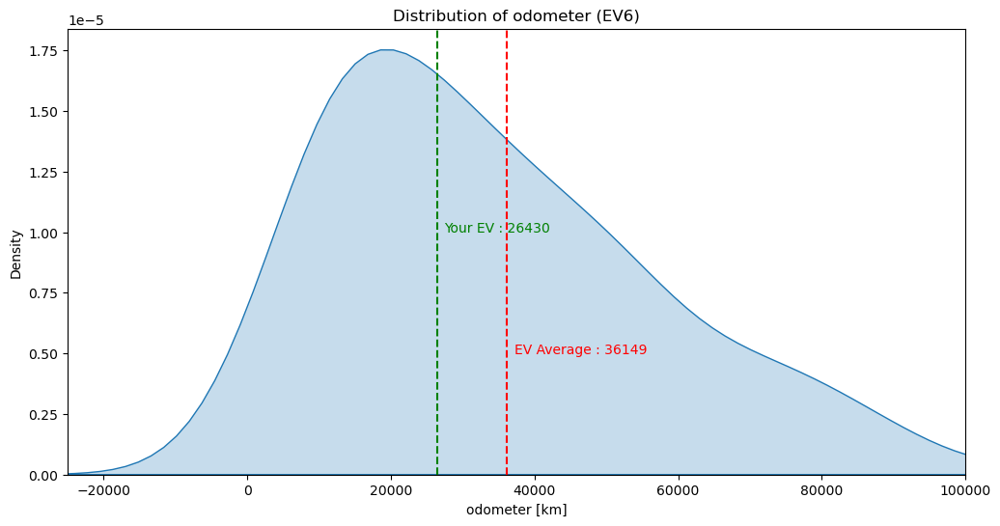

In [185]:
# odometer 데이터 시각화

data = Data_odometer

plt.figure(figsize=(12, 6))
sns.kdeplot(data['end_odometer'], fill=True)  # KDE 플롯을 생성합니다.

# 그래프에 평균 수치 표기
specific_value = 36149
plt.axvline(x=specific_value, color='r', linestyle='--')  # 특정 수치에 해당하는 선을 그래프에 추가합니다.
plt.text(specific_value + 1000, 0.5e-5, 'EV Average : ' + str(specific_value), color='r')  # 원하는 위치에 특정 수치를 표기합니다.

# 그래프에 특정 수치 표기
specific_value = 26430
plt.axvline(x=specific_value, color='g', linestyle='--')  # 특정 수치에 해당하는 선을 그래프에 추가합니다.
plt.text(specific_value + 1000, 1e-5, 'Your EV : ' + str(specific_value), color='g')  # 원하는 위치에 특정 수치를 표기합니다.

# 그래프 제목, 축 라벨 등 추가
plt.title('Distribution of odometer (EV6)')
plt.xlim(-25000, 100000)
plt.xlabel('odometer [km]')
plt.ylabel('Density')

# 그래프 출력
plt.show()

In [187]:
# 순위 퍼센트로 확인하기

target_value = 26430

percentile_rank = percentileofscore(data['end_odometer'], target_value)
print(f"{target_value}가 데이터에서 차지하는 순위는 상위 {100 - percentile_rank:.2f}% 입니다.")

26430가 데이터에서 차지하는 순위는 상위 54.03% 입니다.


In [85]:
# 평균데이터 정리

pivot_select = pd.pivot_table(Dataset, values=['end_odometer', 'ep_ratio', 'month_ep_ratio', 'cell_voltage_diff', 'fast_charge_ratio'], index='car_model', aggfunc='mean')
pivot_select = pivot_select.fillna(0)

pivot_select.sort_values(by='end_odometer', ascending=False)

,cell_voltage_diff,end_odometer,ep_ratio,fast_charge_ratio,month_ep_ratio
car_model,,,,,
아이오닉일렉트릭(AE),0.1080,114710.3000,5.0438,0.0420,4.7962
니로EV(~2021년식),0.0829,109538.4286,6.7371,0.1566,4.7529
코나EV,0.1341,109533.7059,66.2588,0.1662,4.7376
포터2,0.1091,69839.7841,28.4387,0.3641,2.9486
아이오닉5(2023~),0.0600,65818.0000,5.2400,0.0280,5.1400
봉고3,0.1762,53751.8108,300.9484,0.4479,2.6297
아이오닉5,0.1008,45663.7115,11.8646,0.0471,3.9598
아이오닉5스탠다드,0.1700,40296.5000,3.7300,0.1375,3.6050
EV6,0.0726,36149.8306,8.0199,0.0840,4.0068


### Normal, Reset 분리 확인

In [38]:
# Noraml, Reset 테이블 분리

normal_df = Dataset[Dataset['reset_TF'] == 0]
reset_df = Dataset[Dataset['reset_TF'] == 1]

normal_df.head()

,upload_date,car_model,car_id,start_time,end_time,time_range,cum_currentcharged,cum_currentdischarged,start_odometer,end_odometer,...,reset_rev,power_reset_value,rev_ep_ratio,reset_final,record_time_ratio,cell_cnt,cell_voltage_diff,fast_charge_ratio,overheating_time,subcooling_time
0,2024-04-16 15:20:37,아이오닉5,01241228013,2022-12-08 16:10:19,2023-10-16 19:49:35,312,4856.7000,4560.0000,19379.0000,28240.0000,...,None,-509.1450,5.5700,0,7.1000,180,0.0800,0.1590,0,0
2,2024-04-16 15:20:37,EV6,01241364628,2023-08-28 14:43:37,2024-04-15 20:31:49,231,2713.8000,2595.9000,6025.0000,14142.0000,...,1,-49.9904,5.3400,0,11.4000,192,0.0400,0.0050,0,2
3,2024-04-16 15:20:37,EV6,01241248891,2023-01-16 12:09:05,2024-04-15 17:21:22,455,7672.1000,7432.2000,2511.0000,29295.0000,...,None,172.4940,4.0400,0,15.8000,192,0.1200,0.0130,0,0
5,2024-04-16 15:20:37,아이오닉5,01241228014,2023-05-01 02:30:35,2024-04-15 23:59:58,350,19661.5000,19137.8000,27851.0000,85000.0000,...,1,-189.1070,4.4000,0,34.7000,180,0.1800,0.0080,0,6
8,2024-04-16 15:20:37,EV6,01241364688,2023-05-30 07:14:56,2024-04-15 17:59:30,321,8352.3000,8048.1000,17721.0000,42616.0000,...,None,-33.4486,5.2700,0,17.5000,192,0.0800,0.0070,0,0


In [39]:
reset_df.head()

,upload_date,car_model,car_id,start_time,end_time,time_range,cum_currentcharged,cum_currentdischarged,start_odometer,end_odometer,...,reset_rev,power_reset_value,rev_ep_ratio,reset_final,record_time_ratio,cell_cnt,cell_voltage_diff,fast_charge_ratio,overheating_time,subcooling_time
1,2024-04-16 15:20:37,포터2,01241321907,2023-02-21 13:48:48,2023-11-30 09:00:30,281,2870.6000,2788.0000,26279.0000,74191.0000,...,0,1169.6500,4.2000,1,24.7000,90,0.1600,0.3150,0,0
4,2024-04-16 15:20:37,EV6,01241597765,2023-10-24 09:42:27,2024-04-15 09:22:25,173,5753.4000,5585.8000,28239.0000,39630.0000,...,None,-4084.4200,4.1000,0,10.0000,192,0.0800,0.1970,0,0
6,2024-04-16 15:20:37,EV6,01241597728,2023-09-12 16:18:41,2024-04-15 18:25:24,216,5604.1000,5457.1000,36153.0000,47235.0000,...,None,-7380.9300,3.6800,0,15.9000,192,0.1000,0.0100,0,6
7,2024-04-16 15:20:37,EV6,01241228061,2022-12-19 13:32:15,2024-04-15 09:13:17,482,1914.3000,1844.9000,35886.0000,59252.0000,...,0,-1950.0200,3.8500,0,12.1000,192,0.1000,0.0300,0,0
9,2024-04-16 15:20:37,포터2,01241228171,2022-12-21 17:31:40,2024-04-15 20:08:49,481,5155.3000,5021.1000,23143.0000,81659.0000,...,0,205.8560,4.2700,1,35.4000,90,0.4800,0.0650,0,0


In [40]:
# 데이터 Pivot 정리

pivot_y_odo = pd.pivot_table(normal_df, values='year_odometer', index='car_model', aggfunc='mean')
pivot_y_odo = pivot_y_odo.fillna(0)
pivot_y_odo = pivot_y_odo.sort_values(by='year_odometer')
pivot_y_odo

,year_odometer
car_model,
코나EV,12193.5000
GV60,15304.6875
아이오닉일렉트릭(AE),18882.3750
EV6스탠다드,20213.4000
EV6,23786.4901
아이오닉5,23827.4839
포터2,27140.0769
아이오닉6,27792.6000
봉고3,27924.1818


In [41]:
# 시각화 하기 (Bar Plot)

input_df = pivot_y_odo
x_name = 'year_odometer'
y_name = pivot_y_odo.index

pu.plotly_bar(input_df, x_name, y_name)

In [42]:
normal_df[['upload_date', 'car_model', 'car_id', 'start_time', 'end_time',
       'start_odometer', 'end_odometer', 'odometer', 'year_odometer']]

,upload_date,car_model,car_id,start_time,end_time,start_odometer,end_odometer,odometer,year_odometer
0,2024-04-16 15:20:37,아이오닉5,01241228013,2022-12-08 16:10:19,2023-10-16 19:49:35,19379.0000,28240.0000,8861.0000,10366.0000
2,2024-04-16 15:20:37,EV6,01241364628,2023-08-28 14:43:37,2024-04-15 20:31:49,6025.0000,14142.0000,8117.0000,12826.0000
3,2024-04-16 15:20:37,EV6,01241248891,2023-01-16 12:09:05,2024-04-15 17:21:22,2511.0000,29295.0000,26784.0000,21486.0000
5,2024-04-16 15:20:37,아이오닉5,01241228014,2023-05-01 02:30:35,2024-04-15 23:59:58,27851.0000,85000.0000,57149.0000,59598.0000
8,2024-04-16 15:20:37,EV6,01241364688,2023-05-30 07:14:56,2024-04-15 17:59:30,17721.0000,42616.0000,24895.0000,28307.0000
...,...,...,...,...,...,...,...,...,...
494,2024-04-16 15:20:37,아이오닉5,01241597856,2024-04-05 17:03:55,2024-04-15 20:03:38,6251.0000,6503.0000,252.0000,9198.0000
495,2024-04-16 15:20:37,EV6,01241597819,2024-01-18 17:57:27,2024-04-15 18:25:45,4483.0000,9022.0000,4539.0000,18827.0000
498,2024-04-16 15:20:37,포터2,01241321914,2023-04-03 08:17:36,2024-04-15 23:59:58,27006.0000,34634.0000,7628.0000,7366.0000
499,2024-04-16 15:20:37,EV6,01241288308,2024-03-05 11:29:21,2024-04-15 15:01:32,43175.0000,46432.0000,3257.0000,28995.0000


In [43]:
car_info

,car_num,reg_date,car_model,release,cell_cnt,batteryReplace,qstd
0,01229662196,2022-10-07 02:59:47,GV60,20220623,192,,111.0000
1,01229663082,2022-09-23 07:32:12,GV60,20220301,192,,111.0000
2,01229663432,2022-10-07 02:57:24,GV60,20220615,192,,111.0000
3,01229664528,2022-10-07 02:57:48,GV60,20220615,192,,111.0000
4,01229994779,2022-09-16 01:19:57,아이오닉5,20220301,180,2022-12,111.0000
...,...,...,...,...,...,...,...
514,01241248539,2024-04-03 15:30:00,EV6,20221201,192,,111.0000
515,01241597857,2024-04-05 16:30:00,아이오닉5,20221201,180,2020-10,111.0000
516,01241597856,2024-04-05 16:30:00,아이오닉5,20221201,180,,111.0000
517,01241597853,2024-04-05 16:30:00,아이오닉5,20221201,180,,111.0000


In [44]:
# 데이터 Pivot 정리 (차종별, 평균)

all_odo = df_summary.groupby('car_model').agg({'end_odometer': 'mean', })
all_count = car_info.groupby('car_model').agg({'car_model': 'count', })
all_odo = pd.merge(left = all_count , right = all_odo, how = "inner", left_index=True, right_index=True )

custum_pivot = pd.pivot_table(normal_df, values=['odometer','end_odometer', 'cum_currentdischarged', 'year_odometer', 'cycle',
       'nominal_energy', 'public_ratio', 'ep_ratio', 'month_ep_ratio'], index='car_model', aggfunc='mean')

custum_pivot = pd.merge(left = custum_pivot , right = all_odo, how = "left", left_index=True, right_index=True )

In [45]:
custum_pivot.to_csv('./bos_monthly_report/custum_pivot_2403.csv', encoding='utf-8-sig')

In [46]:
input_df = custum_pivot
x_name = 'odometer'
y_name = 'month_ep_ratio'
z_name = input_df.index

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [47]:
# 주행거리 vs 누적방전량 (전비 Trendline)

input_df = Dataset
x_name = 'odometer'
y_name = 'cum_currentdischarged'
z_name = 'car_model'

pu.plotly_trendline(input_df, x_name, y_name, z_name)

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.217
Model:                            OLS   Adj. R-squared:                  0.215
Method:                 Least Squares   F-statistic:                     138.2
Date:                Wed, 17 Apr 2024   Prob (F-statistic):           2.49e-28
Time:                        15:41:34   Log-Likelihood:                -5220.4
No. Observations:                 501   AIC:                         1.044e+04
Df Residuals:                     499   BIC:                         1.045e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       2767.0170    575.593      4.807      0.0

In [48]:
Dataset.columns

Index(['upload_date', 'car_model', 'car_id', 'start_time', 'end_time',
       'time_range', 'cum_currentcharged', 'cum_currentdischarged',
       'start_odometer', 'end_odometer', 'odometer', 'year_odometer', 'cycle',
       'nominal_energy', 'public_ratio', 'ep_ratio', 'month_ep_ratio',
       'reset_TF', 'reset_time', 'reset_start', 'reset_end', 'reset_rev',
       'power_reset_value', 'rev_ep_ratio', 'reset_final', 'record_time_ratio',
       'cell_cnt', 'cell_voltage_diff', 'fast_charge_ratio',
       'overheating_time', 'subcooling_time'],
      dtype='object')

In [49]:
# 시각화 하기 (Scatter Plot, record_time : BMS 작동 시간 비율)

input_df = Dataset
x_name = 'car_id'
y_name = 'record_time_ratio'
z_name = 'car_model'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [50]:
# 시각화 하기 (Scatter Plot)

input_df = Dataset
x_name = 'car_id'
y_name = 'cell_voltage_diff'
z_name = 'car_model'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [51]:
Dataset[Dataset['car_id'] == '01241228038']['power_reset_value']

197   154888.0000
Name: power_reset_value, dtype: float64

## LifeCycle view

In [52]:
sq.view_tablelist(conn)

,table_name
0,cal_soh
1,cal_soh_v2
2,car_info
3,car_spec
4,drive_record
5,exe_log
6,fin_result
7,fin_result_v2
8,lifecycle_fitting
9,lifecycle_predict


In [53]:
# 데이터 조회하기  (LifeCycle_fitting)

start_time = time.time()

# 컬럼명 확인 하기

table_name = 'lifecycle_fitting'

df_lifecycle = sq.read_table_all(conn, table_name)

# 최근 데이터만 가져오기

resent_time = df_lifecycle['upload_date'].unique()[-1:][0]
df_lifecycle = df_lifecycle[df_lifecycle['upload_date'] == resent_time].reset_index(drop=True)

end_time = time.time()

spend_time = end_time - start_time
spend_min = spend_time//60
sec = spend_time%60
print('Time spend : ', int(spend_min), 'min', round(sec, 2), 'sec')

df_lifecycle.head()

Table name :  lifecycle_fitting
Time spend :  0 min 0.32 sec


,upload_date,car_id,car_model,charge_point,life_cycle,fit_initial,fit_alpha,r2_score,one_cycle_km,present_year,present_km,initial_km,after_y1_km,after_y3_km,after_y5_km,fit_code,egmp_TF,reset_TF
0,2024-02-27 04:27:34,01241228134,EV6,14,3649.0000,102.5820,-0.0001,0.7732,367.6500,0.4100,375.6770,377.1420,372.1280,365.1310,358.2650,OK,1,0
1,2024-02-27 04:27:34,01241248714,봉고3,42,14563.0000,105.4780,-0.0000,0.8553,170.5200,2.2400,177.9540,179.8620,177.1080,175.4300,173.7670,OK,0,0
2,2024-02-27 04:27:34,01241364688,EV6,20,1632.0000,102.8930,-0.0002,0.8840,367.6500,1.3200,372.3850,378.2860,367.9760,359.3140,350.8550,OK,1,0
3,2024-02-27 04:27:34,01241228177,포터2,15,4098.0000,105.7020,-0.0001,0.9613,170.5200,3.1500,176.3590,180.2420,175.1430,172.7380,170.3650,OK,0,0
4,2024-02-27 04:27:34,01241248671,포터2,50,14776.0000,105.5710,-0.0000,0.8884,170.5200,3.4900,177.5010,180.0200,176.7860,175.3640,173.9530,OK,0,0


In [54]:
# 시각화 하기 (Scatter Plot, SOH 초기값)

input_df = df_lifecycle
x_name = 'car_id'
y_name = 'fit_initial'
z_name = 'car_model'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [55]:
# 충전 회수 10회 이상만 선택

df_10up = df_lifecycle[df_lifecycle['charge_point'] >= 10]
df_10up.head()

,upload_date,car_id,car_model,charge_point,life_cycle,fit_initial,fit_alpha,r2_score,one_cycle_km,present_year,present_km,initial_km,after_y1_km,after_y3_km,after_y5_km,fit_code,egmp_TF,reset_TF
0,2024-02-27 04:27:34,01241228134,EV6,14,3649.0000,102.5820,-0.0001,0.7732,367.6500,0.4100,375.6770,377.1420,372.1280,365.1310,358.2650,OK,1,0
1,2024-02-27 04:27:34,01241248714,봉고3,42,14563.0000,105.4780,-0.0000,0.8553,170.5200,2.2400,177.9540,179.8620,177.1080,175.4300,173.7670,OK,0,0
2,2024-02-27 04:27:34,01241364688,EV6,20,1632.0000,102.8930,-0.0002,0.8840,367.6500,1.3200,372.3850,378.2860,367.9760,359.3140,350.8550,OK,1,0
3,2024-02-27 04:27:34,01241228177,포터2,15,4098.0000,105.7020,-0.0001,0.9613,170.5200,3.1500,176.3590,180.2420,175.1430,172.7380,170.3650,OK,0,0
4,2024-02-27 04:27:34,01241248671,포터2,50,14776.0000,105.5710,-0.0000,0.8884,170.5200,3.4900,177.5010,180.0200,176.7860,175.3640,173.9530,OK,0,0


In [56]:
# 시각화 하기 (Scatter Plot, SOH 초기값)

input_df = df_10up
x_name = 'car_id'
y_name = 'fit_initial'
z_name = 'car_model'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [57]:
# 현재 SOH 수준 확인 하기

df_10up['now_soh'] = df_10up['present_km']/df_10up['one_cycle_km']*100
df_10up

C:\Users\minms\AppData\Local\Temp\ipykernel_3032\352272606.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,upload_date,car_id,car_model,charge_point,life_cycle,fit_initial,fit_alpha,r2_score,one_cycle_km,present_year,present_km,initial_km,after_y1_km,after_y3_km,after_y5_km,fit_code,egmp_TF,reset_TF,now_soh
0,2024-02-27 04:27:34,01241228134,EV6,14,3649.0000,102.5820,-0.0001,0.7732,367.6500,0.4100,375.6770,377.1420,372.1280,365.1310,358.2650,OK,1,0,102.1833
1,2024-02-27 04:27:34,01241248714,봉고3,42,14563.0000,105.4780,-0.0000,0.8553,170.5200,2.2400,177.9540,179.8620,177.1080,175.4300,173.7670,OK,0,0,104.3596
2,2024-02-27 04:27:34,01241364688,EV6,20,1632.0000,102.8930,-0.0002,0.8840,367.6500,1.3200,372.3850,378.2860,367.9760,359.3140,350.8550,OK,1,0,101.2879
3,2024-02-27 04:27:34,01241228177,포터2,15,4098.0000,105.7020,-0.0001,0.9613,170.5200,3.1500,176.3590,180.2420,175.1430,172.7380,170.3650,OK,0,0,103.4242
4,2024-02-27 04:27:34,01241248671,포터2,50,14776.0000,105.5710,-0.0000,0.8884,170.5200,3.4900,177.5010,180.0200,176.7860,175.3640,173.9530,OK,0,0,104.0939
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
474,2024-02-27 04:27:34,01241248645,봉고3,14,9198.0000,106.5110,-0.0000,0.8374,170.5200,3.4100,179.4000,181.6220,178.7530,177.4670,176.1900,OK,0,1,105.2076
475,2024-02-27 04:27:34,01241248700,포터2,12,10347.0000,105.7060,-0.0000,0.9813,170.5200,3.1500,177.8820,180.2500,177.1360,175.6550,174.1860,OK,0,1,104.3174
476,2024-02-27 04:27:34,01241248770,포터2,42,20625.0000,104.7850,-0.0000,0.2505,170.5200,3.2400,175.9090,178.6800,175.0620,173.3810,171.7160,OK,0,1,103.1603
478,2024-02-27 04:27:34,01241248749,봉고3,30,2896.0000,105.5470,-0.0001,0.9731,170.5200,1.4100,175.3650,179.9780,172.1660,165.9400,159.9400,OK,0,1,102.8413


In [58]:
# 전체 데이터 Pivot 정리 (충전 10회 이상)

df10up_pivot = pd.pivot_table(df_10up, values='now_soh', index='car_model', aggfunc=['count', 'mean'])
df10up_pivot = df10up_pivot.fillna(0)

print('Total Car : ', df10up_pivot.iloc[:, 0].sum())

df10up_pivot

Total Car :  186


,count,mean
,now_soh,now_soh
car_model,,
EV6,79,101.6458
EV6스탠다드,3,101.3943
GV60,2,101.2789
봉고3,19,103.2524
아이오닉5,21,101.0890
아이오닉5스탠다드,2,101.2394
아이오닉6,2,101.9158
아이오닉일렉트릭(AE),7,106.4886


In [59]:
# 시각화 하기 (Scatter Plot, 현재 SOH)

input_df = df_10up
x_name = 'car_id'
y_name = 'now_soh'
z_name = 'car_model'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

## 신규알고리즘 버전 SOH(smnoh 추가)

In [61]:
table_name = 'v2_cal_soh'

v2_cal_soh = sq.read_table_all(conn, table_name)
max_cal_soh = v2_cal_soh.groupby('car_id').agg({'model_year':'max',
                                               'end_cycle':'max'})
max_cal_soh.reset_index(inplace=True)
# max_cal_soh

Table name :  v2_cal_soh


In [62]:
table_name = 'v2_fin_result'

v2_rst = sq.read_table_all(conn, table_name)
v2_rst = v2_rst[v2_rst['upload_date']==v2_rst['upload_date'].max()]
v2_rst.columns

Table name :  v2_fin_result


Index(['upload_date', 'car_id', 'car_model', 'model_year', 'charge_point',
       'certi_TF', 'fit_initial', 'fit_alpha', 'r2', 'remainig_year',
       'present_soh', 'after_y1_soh', 'after_y2_soh', 'after_y3_soh',
       'after_y4_soh', 'after_y5_soh', 'after_y6_soh', 'after_y7_soh',
       'after_y8_soh', 'after_y9_soh', 'after_y10_soh', 'model_y0_soh',
       'model_y1_soh', 'model_y2_soh', 'model_y3_soh', 'model_y4_soh',
       'model_y5_soh', 'model_y6_soh', 'model_y7_soh', 'model_y8_soh',
       'model_y9_soh', 'model_y10_soh', 'init_soh', 'init_km', 'present_km',
       'after_y1_km', 'after_y3_km', 'one_cycle_km', 'best_worst_coef',
       'reset_TF'],
      dtype='object')

In [63]:
# 시각화 하기 (Scatter Plot, 현재 SOH)

input_df = v2_rst[v2_rst['charge_point']>=10]
x_name = 'car_id'
y_name = 'present_soh'
z_name = 'car_model'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [64]:
# Worst Case 확인 (fit 기울기 기준)

df_10up = v2_rst[v2_rst['charge_point']>=10]
df_min_soh = pd.DataFrame(columns=df_10up.columns)

for i, n in enumerate(df_10up['car_model'].unique()):
    
    select_car = n

    select_df = df_10up[df_10up['car_model'] == select_car].sort_values(by='fit_alpha')
    select_df = select_df.reset_index(drop=True)
    
    df_min_soh.loc[i] = select_df.iloc[0]

df_min_soh = pd.merge(left = df_min_soh , right = max_cal_soh, how = "left", on = "car_id")
csv_worst_df = df_min_soh[['car_model','car_id','fit_initial','present_soh','fit_alpha','end_cycle','remainig_year']]
csv_worst_df.to_csv('./bos_monthly_report/2403_worst_case.csv', encoding='utf-8-sig')
csv_worst_df

,car_model,car_id,fit_initial,present_soh,fit_alpha,end_cycle,remainig_year
0,아이오닉5,01241597802,102.7100,99.9800,-0.0196,79.8898,12.7600
1,EV6,01241597817,103.9700,99.7400,-0.0756,55.5039,3.4700
2,코나EV,01241248727,105.6000,102.8000,-0.0071,202.5590,39.2300
3,아이오닉일렉트릭(AE),01241228096,108.0000,106.0000,-0.0039,593.1570,75.9900
4,아이오닉5스탠다드,01241592895,102.6600,100.9000,-0.0101,154.1070,24.6700
5,포터2,01241248729,105.2700,100.7000,-0.0246,71.0952,11.1500
6,EV6스탠다드,01241597787,101.9500,99.9000,-0.0322,29.3027,7.5300
7,GV60,01241228143,102.6400,99.5500,-0.0156,92.3566,16.0000
8,봉고3,01241228161,105.8600,101.6400,-0.0178,144.6050,15.7400
9,니로EV(~2021년식),01241228155,104.5300,102.7700,-0.0176,206.7910,15.1800


In [65]:
df_min_soh[df_min_soh['car_model'] == 'GV60'].loc[:, ['car_model', 'car_id', 'fit_initial', 'present_soh', 'fit_alpha']]

,car_model,car_id,fit_initial,present_soh,fit_alpha
7,GV60,01241228143,102.6400,99.5500,-0.0156


In [66]:
# Best Case 확인

df_max_soh = pd.DataFrame(columns=df_10up.columns)

for i, n in enumerate(df_10up['car_model'].unique()):
    
    select_car = n

    select_df = df_10up[(df_10up['car_model'] == select_car)&(df_10up['fit_alpha'] < 0) ].sort_values(by='fit_alpha', ascending = False)
    select_df = select_df.reset_index(drop=True)
    
    df_max_soh.loc[i] = select_df.iloc[0]
    
df_max_soh = pd.merge(left = df_max_soh , right = max_cal_soh, how = "left", on = "car_id")
csv_best_df = df_max_soh[['car_model','car_id','fit_initial','present_soh','fit_alpha','end_cycle','remainig_year']]
csv_best_df.to_csv('./bos_monthly_report/2403_best_case.csv', encoding='utf-8-sig')
csv_best_df

,car_model,car_id,fit_initial,present_soh,fit_alpha,end_cycle,remainig_year
0,아이오닉5,01241248815,101.4000,101.2100,-0.0012,193.7660,190.0500
1,EV6,01241228134,101.3600,101.3100,-0.0009,220.4730,265.8700
2,코나EV,01241124056,103.3900,102.0600,-0.0025,88.2750,101.5300
3,아이오닉일렉트릭(AE),01241228127,107.6800,106.0500,-0.0025,753.0070,120.6200
4,아이오닉5스탠다드,01241228018,101.4700,101.1800,-0.0018,218.7620,129.5300
5,포터2,01241321907,103.7900,103.6200,-0.0009,369.0100,277.7500
6,EV6스탠다드,01241364649,101.5600,101.5100,-0.0004,78.4524,599.8300
7,GV60,01241228137,102.3000,101.0300,-0.0052,137.3660,46.8900
8,봉고3,01241248749,104.1100,103.8400,-0.0017,317.8420,157.8400
9,니로EV(~2021년식),01241228153,105.3100,103.6300,-0.0029,187.8630,94.8900


In [67]:
pd.concat([df_max_soh[['car_id','car_model','fit_alpha','end_cycle','remainig_year','charge_point']],
           df_min_soh[['car_id','car_model','fit_alpha','end_cycle','remainig_year','charge_point']] ], axis=1)

,car_id,car_model,fit_alpha,end_cycle,remainig_year,charge_point,car_id,car_model,fit_alpha,end_cycle,remainig_year,charge_point
0,01241248815,아이오닉5,-0.0012,193.7660,190.0500,80.0000,01241597802,아이오닉5,-0.0196,79.8898,12.7600,10.0000
1,01241228134,EV6,-0.0009,220.4730,265.8700,42.0000,01241597817,EV6,-0.0756,55.5039,3.4700,13.0000
2,01241124056,코나EV,-0.0025,88.2750,101.5300,18.0000,01241248727,코나EV,-0.0071,202.5590,39.2300,19.0000
3,01241228127,아이오닉일렉트릭(AE),-0.0025,753.0070,120.6200,53.0000,01241228096,아이오닉일렉트릭(AE),-0.0039,593.1570,75.9900,90.0000
4,01241228018,아이오닉5스탠다드,-0.0018,218.7620,129.5300,74.0000,01241592895,아이오닉5스탠다드,-0.0101,154.1070,24.6700,34.0000
5,01241321907,포터2,-0.0009,369.0100,277.7500,117.0000,01241248729,포터2,-0.0246,71.0952,11.1500,13.0000
6,01241364649,EV6스탠다드,-0.0004,78.4524,599.8300,52.0000,01241597787,EV6스탠다드,-0.0322,29.3027,7.5300,16.0000
7,01241228137,GV60,-0.0052,137.3660,46.8900,30.0000,01241228143,GV60,-0.0156,92.3566,16.0000,12.0000
8,01241248749,봉고3,-0.0017,317.8420,157.8400,130.0000,01241228161,봉고3,-0.0178,144.6050,15.7400,45.0000
9,01241228153,니로EV(~2021년식),-0.0029,187.8630,94.8900,23.0000,01241228155,니로EV(~2021년식),-0.0176,206.7910,15.1800,19.0000


In [68]:
# SOH에 대한 Curve 그래프 (Worst case)

dataset = df_min_soh
car_model = 'GV60'   # 차종 선택

dataset = dataset[dataset['car_model'] == car_model]
col_1 = 'fit_initial'
col_2 = 'fit_alpha'

soh_min_trend_list = []
cycle_end = 30

def func(t, a, b):
    return a * np.exp(b*t)
    
t = np.arange(cycle_end)
a = dataset[col_1].head().values[0]
b = dataset[col_2].head().values[0]

soh_out = func(t, a, b)

# initial correction (100% 기준으로 조정)
#     correct = a-100
#     soh_out = soh_out - correct
####################
    
soh_min_trend_list.append(soh_out)

In [69]:
# SOH에 대한 Curve 그래프 (Best case)

dataset = df_max_soh

dataset = dataset[dataset['car_model'] == car_model]
col_1 = 'fit_initial'
col_2 = 'fit_alpha'

soh_max_trend_list = []
cycle_end = 30

def func(t, a, b):
    return a * np.exp(b*t)
    
t = np.arange(cycle_end)
a = dataset[col_1].head().values[0]
b = dataset[col_2].head().values[0]

soh_out = func(t, a, b)

# initial correction (100% 기준으로 조정)
#     correct = a-100
#     soh_out = soh_out - correct
####################
    
soh_max_trend_list.append(soh_out)

In [70]:
# 시각화 하기 (Line Plot)

fig = go.Figure()

t = np.arange(cycle_end)
fig.add_trace(go.Scatter(x=t, y=soh_min_trend_list[0], mode='lines', name=car_model+str('_worst')))
fig.add_trace(go.Scatter(x=t, y=soh_max_trend_list[0], mode='lines', name=car_model+str('_best')))

fig.update_layout(title_text = 'SOH Prediction (B-OnScope)')
fig.update_layout(template ='plotly_dark', width=600, height=500)
fig.update_xaxes(title_text = 'Model year')
fig.update_yaxes(range=[40, 110], title_text = 'SOH[%]')
fig.show()

In [46]:
# df_max_soh[df_max_soh['car_model'] == car_model].loc[:, ['car_model', 'car_id', 'fit_initial', 'now_soh', 'fit_alpha', 'life_cycle']]

In [48]:
# df_min_soh[df_min_soh['car_model'] == car_model].loc[:, ['car_model', 'car_id', 'fit_initial', 'now_soh', 'fit_alpha', 'life_cycle']]

In [72]:
# 시각화 하기 (km 환산)

fig = go.Figure()

kwh = car_spec['nominal_energy'][car_spec['car_model'] == car_model].values[0]
km_per_kwh = car_spec['energy_efficiency'][car_spec['car_model'] == car_model].values[0]

cycle_to_km = kwh * km_per_kwh    

t = [m * cycle_to_km for m in list(np.arange(cycle_end))]
fig.add_trace(go.Scatter(x=t, y=soh_min_trend_list[0], mode='lines', name=car_model+str('_worst')))
fig.add_trace(go.Scatter(x=t, y=soh_max_trend_list[0], mode='lines', name=car_model+str('_best')))
# fig.add_trace(go.Scatter(x=[600000], y=[90.5], mode='markers', name=car_model+str('_LIB_check')))

fig.update_layout(title_text = 'SOH Prediction (B-OnScope)')
fig.update_layout(template ='plotly_dark', width=600, height=500)
# fig.update_xaxes(range=[0, 800000], title_text = 'mileage[km]')
fig.update_yaxes(range=[60, 110], title_text = 'SOH[%]')

fig.show()

## SOH Calculation View

In [73]:
# 데이터 조회하기  (cal_soh)

start_time = time.time()

# 컬럼명 확인 하기

table_name = 'cal_soh'

df_cal_soh = sq.read_table_all(conn, table_name)

# 최근 데이터만 가져오기

resent_time = df_cal_soh['upload_date'].unique()[-1:][0]
df_cal_soh = df_cal_soh[df_cal_soh['upload_date'] == resent_time].reset_index(drop=True)

end_time = time.time()

spend_time = end_time - start_time
spend_min = spend_time//60
sec = spend_time%60
print('Time spend : ', int(spend_min), 'min', round(sec, 2), 'sec')

df_cal_soh.head()

Table name :  cal_soh
Time spend :  0 min 5.19 sec


,upload_date,car_id,car_model,start_index,end_index,start_time,end_time,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_cycle,end_soh,delta_Q,SOH_prediction,time_index,recent_time
0,2024-02-27 04:27:29,01241248711,포터2,3201870,3204205,2023-12-02 10:13:20,2023-12-02 12:23:53,28.5000,85.0000,56.5000,56743,20511.3000,348.8320,100.0000,109.1000,107.2800,2023-12-02 12:23:53,73
1,2024-02-27 04:27:29,01241248711,포터2,3347452,3349770,2023-11-18 20:19:13,2023-11-18 21:44:41,30.5000,89.5000,59.0000,55478,20054.4000,341.0610,100.0000,113.6000,106.9700,2023-11-18 21:44:41,87
2,2024-02-27 04:27:29,01241248711,포터2,3710181,3737737,2023-12-16 18:43:52,2023-12-17 10:02:37,26.0000,78.5000,52.5000,58320,21053.0000,358.0440,100.0000,101.6000,107.5100,2023-12-17 10:02:37,58
3,2024-02-27 04:27:29,01241248711,포터2,3937353,3967788,2023-12-24 09:02:59,2023-12-25 01:57:43,36.5000,93.0000,56.5000,59099,21334.5000,362.8320,100.0000,109.3000,107.4700,2023-12-25 01:57:43,51
4,2024-02-27 04:27:29,01241248711,포터2,4101210,4102308,2024-01-01 14:47:22,2024-01-01 15:23:59,17.0000,67.0000,50.0000,59825,21593.0000,367.2280,100.0000,96.1000,106.7800,2024-01-01 15:23:59,43


In [74]:
input_df = df_cal_soh
x_name = 'end_cycle'
y_name = 'SOH_prediction'
z_name = 'car_model'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [75]:
# 특정 차량만 선택해서 보기

input_df = df_cal_soh
car_list = ['01241124056']      # 회사 코나 '01241124056'
# car_list = ['01241248842', '01241228032', '01241597804', '01241228143', '01241228033', '01241592895']

select_table = input_df[input_df['car_id'].isin(car_list)]
select_table.head()

,upload_date,car_id,car_model,start_index,end_index,start_time,end_time,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_cycle,end_soh,delta_Q,SOH_prediction,time_index,recent_time
2922,2024-02-27 04:27:29,01241124056,코나EV,1623033,1635023,2023-12-04 11:54:59,2023-12-04 18:34:45,9.5000,71.0000,61.5000,94155,12128.6000,189.5090,100.0000,115.9000,104.7000,2023-12-04 18:34:45,50
2923,2024-02-27 04:27:29,01241124056,코나EV,1688211,1698828,2023-11-12 13:15:07,2023-11-12 19:09:05,39.5000,92.0000,52.5000,92829,11846.0000,185.0940,100.0000,98.9000,104.6600,2023-11-12 19:09:05,72
2924,2024-02-27 04:27:29,01241124056,코나EV,1903712,1915277,2023-12-17 11:57:50,2023-12-17 18:23:25,37.0000,90.0000,53.0000,94723,53.5000,0.8359,100.0000,102.5000,107.4400,2023-12-17 18:23:25,37
2925,2024-02-27 04:27:29,01241124056,코나EV,2021962,2040094,2024-01-03 19:23:35,2024-01-04 05:28:07,10.0000,94.5000,84.5000,95432,234.6000,3.6656,100.0000,163.1000,107.2300,2024-01-04 05:28:07,20
2926,2024-02-27 04:27:29,01241124056,코나EV,2065500,2077624,2024-01-08 08:47:45,2024-01-08 15:32:59,29.0000,85.5000,56.5000,95744,301.8000,4.7156,100.0000,109.1000,107.2800,2024-01-08 15:32:59,15


In [77]:
select_table.tail()

,upload_date,car_id,car_model,start_index,end_index,start_time,end_time,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_cycle,end_soh,delta_Q,SOH_prediction,time_index,recent_time
2922,2024-02-27 04:27:29,01241124056,코나EV,1623033,1635023,2023-12-04 11:54:59,2023-12-04 18:34:45,9.5000,71.0000,61.5000,94155,12128.6000,189.5090,100.0000,115.9000,104.7000,2023-12-04 18:34:45,50
2923,2024-02-27 04:27:29,01241124056,코나EV,1688211,1698828,2023-11-12 13:15:07,2023-11-12 19:09:05,39.5000,92.0000,52.5000,92829,11846.0000,185.0940,100.0000,98.9000,104.6600,2023-11-12 19:09:05,72
2924,2024-02-27 04:27:29,01241124056,코나EV,1903712,1915277,2023-12-17 11:57:50,2023-12-17 18:23:25,37.0000,90.0000,53.0000,94723,53.5000,0.8359,100.0000,102.5000,107.4400,2023-12-17 18:23:25,37
2925,2024-02-27 04:27:29,01241124056,코나EV,2021962,2040094,2024-01-03 19:23:35,2024-01-04 05:28:07,10.0000,94.5000,84.5000,95432,234.6000,3.6656,100.0000,163.1000,107.2300,2024-01-04 05:28:07,20
2926,2024-02-27 04:27:29,01241124056,코나EV,2065500,2077624,2024-01-08 08:47:45,2024-01-08 15:32:59,29.0000,85.5000,56.5000,95744,301.8000,4.7156,100.0000,109.1000,107.2800,2024-01-08 15:32:59,15


In [78]:
input_df = select_table
x_name = 'end_odometer'
y_name = 'SOH_prediction'
z_name = 'car_model'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [79]:
input_df = select_table
x_name = 'end_odometer'
y_name = 'end_soh'
z_name = 'car_model'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [80]:
# 주행거리 vs 누적방전량, 전비에 대한 그래프

standard_ratio = car_spec['energy_efficiency'][car_spec['car_model'] == select_table['car_model'].head(1).values[0]].values[0]

km_end = select_table['end_odometer'].tail(1).values[0] + 1000
a = 1/standard_ratio
b = 0

def func(x, a, b):
    return a * x + b

x = np.arange(km_end)
y_trend = func(x, a, b)

x_input = select_table['end_odometer']
y_input = select_table['end_cumPowDischared']
z_input = select_table['car_id']

p0 = [0.2, -1000]

od = x_input
pw = y_input

c, cov = curve_fit(func, od, pw, p0)

pred_y = func(x, c[0], c[1])

r2 = r2_score(y_input, func(od, c[0], c[1]))

power_reset_value = c[1]
slope = c[0]

revision_pow = select_table['end_cumPowDischared'] - power_reset_value

# 기록 구간 전비 계산

record_kmperkwh = (x_input.tail(1).values[0] - x_input.head(1).values[0]) / (y_input.tail(1).values[0] - y_input.head(1).values[0])

print(c[0], c[1])
print('기록구간전비[km/kwh] : ', record_kmperkwh)

-4.722423297938693 451543.6392798286
기록구간전비[km/kwh] :  -0.13435586971961982


In [81]:
# 시각화 하기 (전비 특성)

fig = go.Figure()

fig.add_trace(go.Scatter(x=x, y=y_trend, mode='lines', text='Standard : ' + str(standard_ratio) + 'km/kwh', name='Standard'))
fig.update_traces(line_color='red', line_width=1, line_dash='dash')

fig.add_trace(go.Scatter(x=x_input, y=y_input, mode='markers', text=z_input, name='Real'))
fig.update_traces(marker_color= 'yellow', marker_size=5)

fig.add_trace(go.Scatter(x=x_input, y=revision_pow, mode='markers', text=z_input, name='Revision'))

fig.add_trace(go.Scatter(x=x, y=pred_y, mode='lines', text='Real : ' + str(round(1/c[0], 2)) + 'km/kwh', name='Real_fit'))
fig.update_traces(line_width=1, line_dash='dash')

fig.update_layout(title_text = '주행거리 vs 누적방전량')
fig.update_layout(template ='plotly_dark', width=600, height=500)
fig.update_xaxes(title_text = '주행거리[km]')
fig.update_yaxes(title_text = '누적방전량[kwh]')

fig.show()

print('Car Model : ', select_table['car_model'].head(1).values[0])
print('Car ID : ', select_table['car_id'].head(1).values[0])
print('data point : ', len(y_input))
print('fit R-squared : ', r2)
print('Power_Reset [kwh] : ', c[1])
print('Real km/kwh : ', round(1/c[0], 2))
print('Standard km/kwh : ', round(standard_ratio, 2))
print('Real/Standard ratio : ', round(1/c[0]/standard_ratio, 2))

Car Model :  코나EV
Car ID :  01241124056
data point :  5
fit R-squared :  0.7145927848221161
Power_Reset [kwh] :  451543.6392798286
Real km/kwh :  -0.21
Standard km/kwh :  5.7
Real/Standard ratio :  -0.04


In [82]:
# SOH 예측값과 BMS 표기값 비교

df_soh_table = select_table.groupby('car_id').agg({'end_soh' : 'min', 'SOH_prediction' : 'min'})

df_soh_table

,end_soh,SOH_prediction
car_id,,
01241124056,100.0000,104.6600


In [83]:
# SOH 예측값과 BMS 표기값 비교 (전체 차량)

df_soh_table = df_cal_soh.groupby('car_id').agg({'end_soh' : 'min', 'SOH_prediction' : 'min'})

df_soh_table.reset_index(inplace=True)
df_soh_table

,car_id,end_soh,SOH_prediction
0,01229663082,100.0000,105.1500
1,01229994779,100.0000,103.3500
2,01241123951,100.0000,102.9400
3,01241124004,100.0000,102.7700
4,01241124056,100.0000,104.6600
...,...,...,...
441,01241597837,100.0000,103.7600
442,01241597847,100.0000,104.3800
443,01241597852,100.0000,103.4200
444,01241597859,100.0000,103.2000


In [84]:
input_df = df_soh_table
x_index = 'car_id'
name1 = 'end_soh'
name2 = 'SOH_prediction'

print('total qty : ', len(input_df))
pu.plotly_2axis(input_df, x_index, name1, name2)

total qty :  446


In [85]:
# 실제 용량 체크 자동차 표기

cap_check = pd.DataFrame({'Car_id' : ['01229994779', '01241123951', '01241124056'],
                         'Check_SOH' : [101.5, 101.4, 98.7]})
cap_check

,Car_id,Check_SOH
0,01229994779,101.5000
1,01241123951,101.4000
2,01241124056,98.7000


In [86]:
# 2개 특성 비교 확인하기

from plotly.subplots import make_subplots

input_df = df_soh_table
x_index = 'car_id'
name1 = 'end_soh'
name2 = 'SOH_prediction'

correlation = input_df[name1].corr(input_df[name2])

fig = make_subplots(specs=[[{'secondary_y' : True}]])

fig.add_trace(go.Scatter(x=input_df[x_index] , y=input_df[name1], mode='lines', name=name1), secondary_y=False,)
fig.add_trace(go.Scatter(x=input_df[x_index] , y=input_df[name2], mode='lines', name=name2), secondary_y=True,)
fig.add_trace(go.Scatter(x=cap_check['Car_id'] , y=cap_check['Check_SOH'], mode='markers', name='battery_check'), secondary_y=True,)

fig.update_layout(title_text = name1 + ' & ' + name2 + ' (Correlation : ' + str(round(correlation, 3)) + ')')
fig.update_layout(template ='plotly_dark', width=900, height=500)
fig.update_xaxes(title_text = 'index')
fig.update_yaxes(range=[90, 110], title_text = 'BMS SOH [%]', secondary_y=False)
fig.update_yaxes(range=[90, 110], title_text = 'Calculation SOH [%]', secondary_y=True)

fig.show()

print('total qty : ', len(input_df))

total qty :  446


## Final Result View

In [87]:
table_name = 'fin_result'

df_fin_result = sq.read_table_all(conn, table_name)

# 최근 데이터만 가져오기

resent_time = df_fin_result['upload_date'].unique()[-1:][0]

predict_result = df_fin_result[df_fin_result['upload_date'] == resent_time].reset_index(drop=True)
predict_result

Table name :  fin_result


,upload_date,car_id,car_model,standard_km,y0_km,y1_km,y2_km,y3_km,y4_km,y5_km,...,model_y8_soh,model_y9_soh,model_y10_soh,present_km,present_year,fit_alpha,charge_point,egmp_TF,reset_TF,best_worst_coef
0,2024-02-27 04:27:36,01241228134,EV6,367.6500,377.1400,373.5800,370.0500,366.5500,363.0900,359.6600,...,96.8100,96.1100,95.4100,375.6770,0.4100,-0.0001,14,1,0,5
1,2024-02-27 04:27:36,01241248714,봉고3,170.5200,179.8600,179.0100,178.1600,177.3100,176.4700,175.6300,...,96.7000,95.8800,95.0700,177.9540,2.2400,-0.0000,42,0,0,5
2,2024-02-27 04:27:36,01241364688,EV6,367.6500,378.2900,373.8100,369.3800,365.0100,360.6900,356.4200,...,96.1800,95.4800,94.7800,372.3850,1.3200,-0.0002,20,1,0,5
3,2024-02-27 04:27:36,01241228177,포터2,170.5200,180.2400,179.0000,177.7700,176.5400,175.3300,174.1200,...,98.9600,98.3700,97.7900,176.3590,3.1500,-0.0001,15,0,0,5
4,2024-02-27 04:27:36,01241248671,포터2,170.5200,180.0200,179.2900,178.5700,177.8500,177.1400,176.4200,...,98.7600,98.1800,97.5900,177.5010,3.4900,-0.0000,50,0,0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
480,2024-02-27 04:27:36,01241228162,봉고3,170.5200,NaN,NaN,NaN,NaN,NaN,NaN,...,96.5600,95.7500,94.9300,NaN,2.4100,NaN,0,0,1,5
481,2024-02-27 04:27:36,01241248752,아이오닉5,352.1100,361.9600,359.7400,357.5400,355.3500,353.1700,351.0100,...,94.6000,93.8800,93.1600,355.9160,2.7400,-0.0001,7,1,1,5
482,2024-02-27 04:27:36,01241597741,EV6,367.6500,383.6600,379.8300,376.0500,372.3000,368.5900,364.9200,...,96.1100,95.4100,94.7200,378.2780,1.4100,-0.0002,12,1,1,5
483,2024-02-27 04:27:36,01241364713,포터2,170.5200,179.0500,179.0500,179.0500,179.0500,179.0500,179.0500,...,99.7900,99.2000,98.6100,179.0460,1.7400,0.0000,1,0,1,5


In [90]:
# 서비스 차량만 선택

df_service = predict_result[(predict_result['egmp_TF'] == 0) & (predict_result['charge_point'] >= 10)]
df_service

,upload_date,car_id,car_model,standard_km,y0_km,y1_km,y2_km,y3_km,y4_km,y5_km,...,model_y8_soh,model_y9_soh,model_y10_soh,present_km,present_year,fit_alpha,charge_point,egmp_TF,reset_TF,best_worst_coef
1,2024-02-27 04:27:36,01241248714,봉고3,170.5200,179.8600,179.0100,178.1600,177.3100,176.4700,175.6300,...,96.7000,95.8800,95.0700,177.9540,2.2400,-0.0000,42,0,0,5
3,2024-02-27 04:27:36,01241228177,포터2,170.5200,180.2400,179.0000,177.7700,176.5400,175.3300,174.1200,...,98.9600,98.3700,97.7900,176.3590,3.1500,-0.0001,15,0,0,5
4,2024-02-27 04:27:36,01241248671,포터2,170.5200,180.0200,179.2900,178.5700,177.8500,177.1400,176.4200,...,98.7600,98.1800,97.5900,177.5010,3.4900,-0.0000,50,0,0,5
19,2024-02-27 04:27:36,01241228096,아이오닉일렉트릭(AE),176.4000,189.5000,188.9900,188.4800,187.9600,187.4500,186.9400,...,105.3600,105.1900,105.0200,187.1570,4.5800,-0.0000,29,0,0,5
47,2024-02-27 04:27:36,01241228127,아이오닉일렉트릭(AE),176.4000,189.4700,189.3400,189.2000,189.0700,188.9400,188.8100,...,105.1100,104.9400,104.7700,188.6690,6.0700,-0.0000,11,0,0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
466,2024-02-27 04:27:36,01241248670,포터2,170.5200,180.1100,179.1800,178.2500,177.3300,176.4100,175.4900,...,100.2800,99.6900,99.1000,179.2610,0.9100,-0.0000,13,0,1,5
474,2024-02-27 04:27:36,01241248645,봉고3,170.5200,181.6200,180.9700,180.3200,179.6700,179.0200,178.3700,...,95.7500,94.9300,94.1300,179.4000,3.4100,-0.0000,14,0,1,5
475,2024-02-27 04:27:36,01241248700,포터2,170.5200,180.2500,179.4900,178.7400,177.9900,177.2500,176.5100,...,98.9600,98.3700,97.7900,177.8820,3.1500,-0.0000,12,0,1,5
476,2024-02-27 04:27:36,01241248770,포터2,170.5200,178.6800,177.8200,176.9600,176.1100,175.2600,174.4200,...,98.9000,98.3200,97.7400,175.9090,3.2400,-0.0000,42,0,1,5


In [91]:
# 특정 연도만 선택 (가장 빠른 퇴화 차량 확인)

input_df = df_service
car_model = '코나EV'
year_value = 'after_y10_soh'

select_df = input_df[input_df['car_model'] == car_model]
select_df_life = select_df.sort_values(by=year_value)
select_df_life = select_df_life.reset_index(drop=True)
select_df_life.loc[:, ['car_id', 'car_model', 'standard_km', 'after_y10_soh', 'present_year', 'fit_alpha']]

,car_id,car_model,standard_km,after_y10_soh,present_year,fit_alpha
0,01241228156,코나EV,364.8000,98.7400,5.4100,-0.0001
1,01241228202,코나EV,364.8000,100.7300,5.3200,-0.0000
2,01241228203,코나EV,364.8000,104.3300,4.9100,-0.0000


In [66]:
car_id = '01241248842'

select_car_summary = df_summary[(df_summary['car_model'] == car_model) & (df_summary['car_id'] == car_id)]
select_car_summary.sort_values(by='year_odometer').loc[:, ['car_id', 'time_range', 'odometer', 'year_odometer', 'cycle',
       'public_ratio', 'ep_ratio', 'month_ep_ratio', 'reset_TF']]

,car_id,time_range,odometer,year_odometer,cycle,public_ratio,ep_ratio,month_ep_ratio,reset_TF
409,01241248842,411,39864.0000,35402.0000,100.6000,4.7500,9.7900,4.7300,1


In [67]:
# SOH 데이터 확인

select_table = df_cal_soh[df_cal_soh['car_id'] == car_id]
select_table.head()

,upload_date,car_id,car_model,start_index,end_index,start_time,end_time,start_soc,end_soc,delta_soc,end_odometer,end_cumPowDischared,end_cycle,end_soh,delta_Q,SOH_prediction,time_index,recent_time
2680,2024-02-27 04:27:29,01241248842,EV6,3007501,3010289,2023-12-15 21:46:49,2023-12-15 23:23:09,18.5000,96.0000,77.5000,68771,6053.1000,78.2054,100.0000,89.2000,103.5000,2023-12-15 23:23:09,70
2681,2024-02-27 04:27:29,01241248842,EV6,3095792,3117531,2023-12-21 19:29:03,2023-12-22 07:33:51,36.5000,89.0000,52.5000,69637,6264.5000,80.9367,100.0000,60.5000,103.6300,2023-12-22 07:33:51,63
2682,2024-02-27 04:27:29,01241248842,EV6,3201056,3220688,2023-12-29 04:36:11,2023-12-29 15:34:38,17.0000,96.5000,79.5000,70500,6482.9000,83.7584,100.0000,91.4000,103.3900,2023-12-29 15:34:38,56
2683,2024-02-27 04:27:29,01241248842,EV6,3250126,3266861,2024-01-05 18:54:56,2024-01-06 04:32:46,31.0000,96.5000,65.5000,70918,6570.1000,84.8850,100.0000,75.4000,103.5200,2024-01-06 04:32:46,48
2684,2024-02-27 04:27:29,01241248842,EV6,3308600,3323723,2024-01-11 19:12:58,2024-01-12 03:37:46,37.5000,88.0000,50.5000,71406,6693.0000,86.4729,100.0000,58.1000,103.4600,2024-01-12 03:37:46,42


In [68]:
input_df = select_table
x_name = 'end_cycle'
y_name = 'SOH_prediction'
z_name = 'car_model'

pu.plotly_scatter(input_df, x_name, y_name, z_name)

In [69]:
pu.plotly_trendline(input_df, x_name, y_name, z_name)

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.054
Model:                            OLS   Adj. R-squared:                 -0.025
Method:                 Least Squares   F-statistic:                    0.6861
Date:                Fri, 22 Mar 2024   Prob (F-statistic):              0.424
Time:                        09:29:15   Log-Likelihood:                 20.784
No. Observations:                  14   AIC:                            -37.57
Df Residuals:                      12   BIC:                            -36.29
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        103.6934      0.257    403.152      0.0

C:\Users\minms\AppData\Roaming\Python\Python310\site-packages\scipy\stats\_stats_py.py:1806: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=14



In [70]:
# 주행거리 vs 누적방전량, 전비에 대한 그래프

standard_ratio = car_spec['energy_efficiency'][car_spec['car_model'] == select_table['car_model'].head(1).values[0]].values[0]

km_end = select_table['end_odometer'].tail(1).values[0] + 1000
a = 1/standard_ratio
b = 0

def func(x, a, b):
    return a * x + b

x = np.arange(km_end)
y_trend = func(x, a, b)

x_input = select_table['end_odometer']
y_input = select_table['end_cumPowDischared']
z_input = select_table['car_id']

p0 = [0.2, -1000]

od = x_input
pw = y_input

c, cov = curve_fit(func, od, pw, p0)

pred_y = func(x, c[0], c[1])

r2 = r2_score(y_input, func(od, c[0], c[1]))

power_reset_value = c[1]
slope = c[0]

revision_pow = select_table['end_cumPowDischared'] - power_reset_value

# 기록 구간 전비 계산

record_kmperkwh = (x_input.tail(1).values[0] - x_input.head(1).values[0]) / (y_input.tail(1).values[0] - y_input.head(1).values[0])

print(c[0], c[1])
print('기록구간전비[km/kwh] : ', record_kmperkwh)

0.2356642407831562 -10142.395248104447
기록구간전비[km/kwh] :  4.253193038184106


In [71]:
# 시각화 하기 (전비 특성)

fig = go.Figure()

fig.add_trace(go.Scatter(x=x, y=y_trend, mode='lines', text='Standard : ' + str(standard_ratio) + 'km/kwh', name='Standard'))
fig.update_traces(line_color='red', line_width=1, line_dash='dash')

fig.add_trace(go.Scatter(x=x_input, y=y_input, mode='markers', text=z_input, name='Real'))
fig.update_traces(marker_color= 'yellow', marker_size=5)

fig.add_trace(go.Scatter(x=x_input, y=revision_pow, mode='markers', text=z_input, name='Revision'))

fig.add_trace(go.Scatter(x=x, y=pred_y, mode='lines', text='Real : ' + str(round(1/c[0], 2)) + 'km/kwh', name='Real_fit'))
fig.update_traces(line_width=1, line_dash='dash')

fig.update_layout(title_text = '주행거리 vs 누적방전량')
fig.update_layout(template ='plotly_dark', width=600, height=500)
fig.update_xaxes(title_text = '주행거리[km]')
fig.update_yaxes(title_text = '누적방전량[kwh]')

fig.show()

print('Car Model : ', select_table['car_model'].head(1).values[0])
print('Car ID : ', select_table['car_id'].head(1).values[0])
print('data point : ', len(y_input))
print('fit R-squared : ', r2)
print('Power_Reset [kwh] : ', c[1])
print('Real km/kwh : ', round(1/c[0], 2))
print('Standard km/kwh : ', round(standard_ratio, 2))
print('Real/Standard ratio : ', round(1/c[0]/standard_ratio, 2))

Car Model :  EV6
Car ID :  01241248842
data point :  14
fit R-squared :  0.999694926086507
Power_Reset [kwh] :  -10142.395248104447
Real km/kwh :  4.24
Standard km/kwh :  4.75
Real/Standard ratio :  0.89


In [72]:
# 주행가능거리 시각화 (year 기준, 보정치 반영)

input_df = df_service
select_carid = '01241597794'    # Worst Case
select_table = input_df[input_df['car_id'] == select_carid]

x = list(range(11))   # 0 ~ 10년 구간
y1 = select_table.iloc[0, 4:15].values    # Noraml
y2 = y1 + select_table.iloc[0, 3] * select_table.iloc[0, len(select_table.columns)-1] / 100    # Best
y3 = y1 - select_table.iloc[0, 3] * select_table.iloc[0, len(select_table.columns)-1] / 100    # Worst

select_model = select_table['car_model'].head(1).values[0]
one_cycle_km = select_table['standard_km'].head(1).values[0]

select_soh = df_cal_soh[df_cal_soh['car_id'] == select_carid]
select_soh = select_soh[select_soh['delta_soc'] > 50]    # delta SOC 50초과만 해당

# 공칭에너지
standard_ratio = car_spec['energy_efficiency'][car_spec['car_model'] == select_model].values[0]       # 공인전비 (km/Kwh)
norminal_kwh = car_spec['nominal_energy'][car_spec['car_model'] == select_model].values[0]      # 공칭에너지 (kwh)
one_cycle_km = norminal_kwh * standard_ratio    # cycle당 주행거리 (km)
one_year_distance = Dataset['year_odometer'][Dataset['car_id'] == select_carid].values[0]            # 1년에 주행거리 (km)
cycle_offset = -power_reset_value/norminal_kwh       # reset에 대한 cycle 보정값
end_cycle = y_input.tail(1).values[0]/norminal_kwh   # 최종 운행 Cycle 값

x_year = (select_soh['end_cycle']+cycle_offset)*one_cycle_km/one_year_distance
y_km_data = select_soh['SOH_prediction']* one_cycle_km/100

fig = go.Figure()

# Scatter Trace 추가
fig.add_trace(go.Scatter(x=x_year, y=y_km_data, mode='markers', name='BMS_data'))
fig.add_trace(go.Scatter(x=x, y=y1, mode='lines', name='평균'))
fig.add_trace(go.Scatter(x=x, y=y2, mode='lines', name='최대'))
fig.add_trace(go.Scatter(x=x, y=y3, mode='lines', name='최소'))
fig.add_trace(go.Scatter(x=x, y=[one_cycle_km for i in range(len(x))], mode='lines', name='SOH 100%'))

fig.update_traces(marker_size=8, line_dash="dash")
fig.update_layout(title_text="Car ID : " + str(select_carid) + " (Model : " + select_model + ")",
                  font=dict(family="Arial", size=16), template ='plotly_dark', width=600, height=500)

fig.update_xaxes(title_text = 'Year')
fig.update_yaxes(title_text = '주행가능거리 [km]')

fig.show()

print('Car Model : ', select_table['car_model'].head(1).values[0])
print('Car ID : ', select_table['car_id'].head(1).values[0])
print('End Odometer [km] : ', x_input.tail(1).values[0])
print('data point : ', len(y_input))
print('fit R-squared : ', r2)
print('Power_Reset [kwh] : ', c[1])
print('Real km/kwh : ', round(1/c[0], 2))
print('Standard km/kwh : ', round(standard_ratio, 2))
print('Real/Standard ratio : ', round(1/c[0]/standard_ratio, 2))
print('One-Cycle-Driving-km : ', round(one_cycle_km, 1))
print('BMS End Cycle : ', round(end_cycle, 1), '(' , round(end_cycle*one_cycle_km/one_year_distance, 1), 'year)')
print('Reset Cycle offset : ', round(cycle_offset, 1), '(' , round(cycle_offset*one_cycle_km/one_year_distance, 1), 'year)' )

Car Model :  EV6
Car ID :  01241597794
End Odometer [km] :  75198
data point :  14
fit R-squared :  0.999694926086507
Power_Reset [kwh] :  -10142.395248104447
Real km/kwh :  4.24
Standard km/kwh :  4.75
Real/Standard ratio :  0.89
One-Cycle-Driving-km :  367.7
BMS End Cycle :  97.7 ( 0.8 year)
Reset Cycle offset :  131.0 ( 1.0 year)


# BMS Data Check

In [73]:
table_id = '01241597794'

df_cardataset = sq.read_table_all(conn_db, table_id)
df_cardataset

Table name :  01241597794


,deviceNo,messageTime,time,startTime,internalTemp,externalTemp,soc,acceptableChargingPower,acceptableDischargingPower,mainRelayConnected,...,estimatedChargingTime,tripChargingPower,tripDischargingPower,battCoolantInletTemp,battPraBusbarTemp,battLtrRearTemp,chargeCount,chargeCountQuick,cumulEnergyChrgd,cumulEnergyChrgdQuick
0,01241597794,2023-11-27 16:00:48,23-11-27 15:59:50,2023-11-27 15:59:50,18,15,56.0000,277.0000,277.0000,1,...,0,0.0000,0.0000,14,12,18,27,28,837,435
1,01241597794,2023-11-27 16:00:48,23-11-27 15:59:52,2023-11-27 15:59:50,18,15,56.0000,277.0000,277.0000,0,...,0,0.0000,0.0000,14,12,18,27,28,837,435
2,01241597794,2023-11-27 16:00:48,23-11-27 15:59:54,2023-11-27 15:59:50,18,15,56.0000,277.0000,277.0000,1,...,0,0.0000,0.0000,14,12,18,27,28,837,435
3,01241597794,2023-11-27 16:00:48,23-11-27 15:59:56,2023-11-27 15:59:50,18,15,56.0000,277.0000,277.0000,1,...,0,0.0000,0.0000,14,12,18,27,28,837,435
4,01241597794,2023-11-27 16:00:48,23-11-27 15:59:58,2023-11-27 15:59:50,19,15,56.0000,277.0000,277.0000,0,...,0,0.0000,0.0000,14,12,18,27,28,837,435
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1182290,01241597794,2024-03-22 09:20:12,24-03-22 09:20:05,2024-03-22 09:19:13,21,10,49.0000,271.0000,271.0000,0,...,0,1.0000,2.0000,9,12,13,58,70,1975,1318
1182291,01241597794,2024-03-22 09:20:12,24-03-22 09:20:07,2024-03-22 09:19:13,21,10,49.0000,271.0000,271.0000,1,...,0,1.0000,2.0000,9,12,13,58,70,1975,1318
1182292,01241597794,2024-03-22 09:20:12,24-03-22 09:20:09,2024-03-22 09:19:13,21,10,49.0000,271.0000,271.0000,0,...,0,1.0000,2.0000,9,12,13,58,70,1975,1318
1182293,01241597794,2024-03-22 09:20:12,24-03-22 09:20:11,2024-03-22 09:19:13,21,10,49.0000,271.0000,271.0000,0,...,0,1.0000,2.0000,9,12,13,58,70,1975,1318


In [74]:
# index를 datetime으로 변경

df_cardataset.loc[:, 'time'] = df_cardataset.loc[:, 'time'].apply(lambda x : '20'+x)
df_cardataset['time'] = pd.to_datetime(df_cardataset['time'])
df_cardataset.set_index('time', drop=True, inplace=True)
df_cardataset.sort_index(inplace=True)
df_cardataset.head()

,deviceNo,messageTime,startTime,internalTemp,externalTemp,soc,acceptableChargingPower,acceptableDischargingPower,mainRelayConnected,slowChargingPortConnected,...,estimatedChargingTime,tripChargingPower,tripDischargingPower,battCoolantInletTemp,battPraBusbarTemp,battLtrRearTemp,chargeCount,chargeCountQuick,cumulEnergyChrgd,cumulEnergyChrgdQuick
time,,,,,,,,,,,,,,,,,,,,,
2023-11-07 14:25:55,01241597794,2023-11-07 14:26:19,2023-11-07 14:25:53,17,16,50.0000,277.0000,277.0000,0,0,...,0,0.0000,0.0000,15,12,19,22,23,615,336
2023-11-07 14:25:57,01241597794,2023-11-07 14:26:19,2023-11-07 14:25:53,17,16,50.0000,277.0000,277.0000,1,0,...,0,0.0000,0.0000,15,12,18,22,23,615,336
2023-11-07 14:25:59,01241597794,2023-11-07 14:26:19,2023-11-07 14:25:53,17,16,50.0000,277.0000,277.0000,0,0,...,0,0.0000,0.0000,15,12,18,22,23,615,336
2023-11-07 14:26:01,01241597794,2023-11-07 14:26:19,2023-11-07 14:25:53,17,16,50.0000,277.0000,277.0000,0,0,...,0,0.0000,0.0000,15,12,18,22,23,615,336
2023-11-07 14:26:03,01241597794,2023-11-07 14:26:19,2023-11-07 14:25:53,17,16,50.0000,277.0000,277.0000,1,0,...,0,0.0000,0.0000,15,12,18,22,23,615,336


In [75]:
df_cardataset.columns

Index(['deviceNo', 'messageTime', 'startTime', 'internalTemp', 'externalTemp',
       'soc', 'acceptableChargingPower', 'acceptableDischargingPower',
       'mainRelayConnected', 'slowChargingPortConnected',
       'fastChargingPortConnected', 'v2l', 'packCurrent', 'packVoltage',
       'moduleMaxTemp', 'moduleMinTemp', 'moduleTempList', 'battInternalTemp',
       'maxCellVoltage', 'maxCellVoltageNo', 'minCellVoltage',
       'minCellVoltageNo', 'battFanRunning', 'subBattVoltage',
       'cumulativeCurrentCharged', 'cumulativeCurrentDischarged',
       'cumulativePowerCharged', 'cumulativePowerDischarged', 'operationTime',
       'bmsRunning', 'inverterCapacityVoltage', 'driveMotorSpd1',
       'driveMotorSpd2', 'insulatedResistance', 'cellVoltageList',
       'cellVoltageDispersion', 'airbagHWireDuty', 'hvacList1', 'hvacList2',
       'soh', 'maxDeteriorationCellNo', 'minDeterioratation',
       'minDeteriorationCellNo', 'socd', 'emobilitySpeed', 'moduleAvgTemp',
       'batteryPower'

Name :  odometer
Total Qty :  1182295
Avg :  14744.55148165221
Min :  8059
Max :  21758
Range :  13699
Std :  3904.748860196122


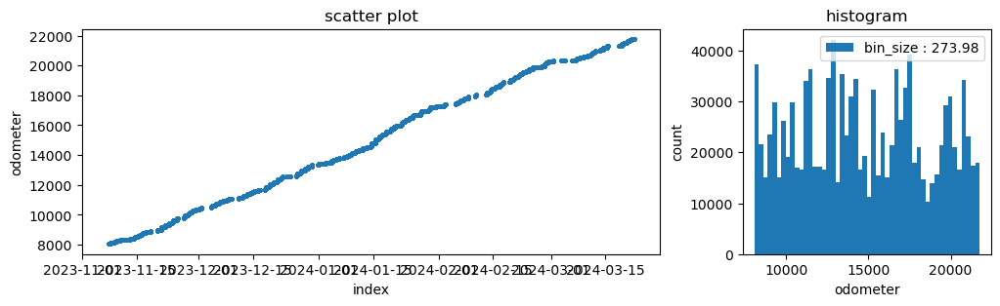

In [76]:
k.plot_feature(df_cardataset, 'odometer')

Name :  soh
Total Qty :  1182295
Avg :  99.99594009955214
Min :  0.0
Max :  100.0
Range :  100.0
Std :  0.6371608159420753


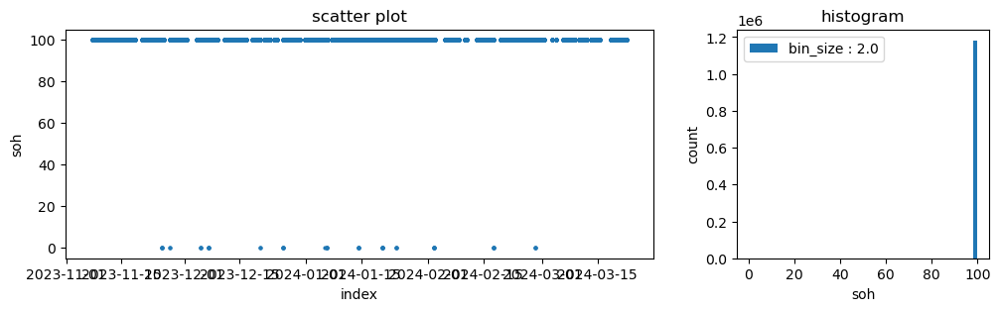

In [77]:
k.plot_feature(df_cardataset, 'soh')

Name :  cumulativeCurrentDischarged
Total Qty :  1182295
Avg :  4677.9445383766315
Min :  0.0
Max :  7099.0
Range :  7099.0
Std :  1369.4081999185055


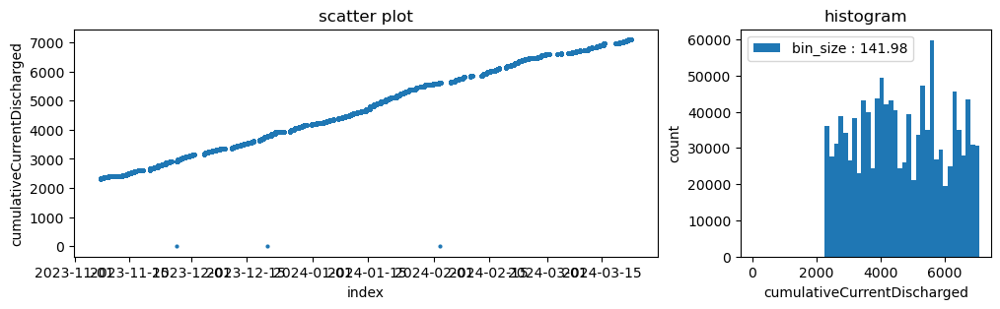

In [78]:
k.plot_feature(df_cardataset, 'cumulativeCurrentDischarged')

Name :  soc
Total Qty :  1182295
Avg :  62.392344550218006
Min :  0.0
Max :  97.0
Range :  97.0
Std :  19.380567941281804


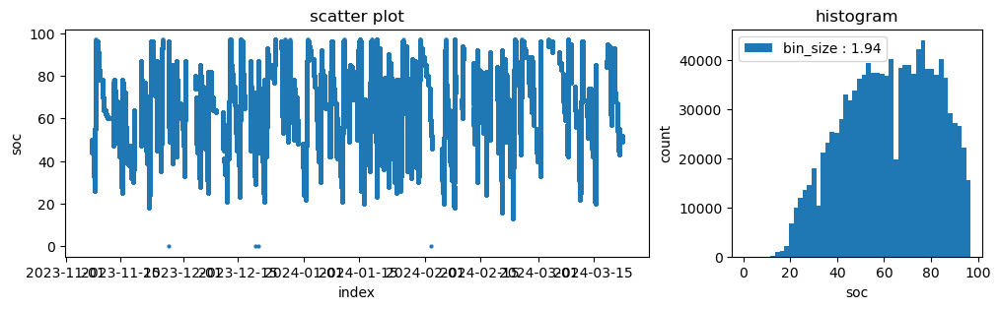

In [79]:
k.plot_feature(df_cardataset, 'soc')